In [1]:
use_tensorboard = False
exp_name = "Oct_26_school_shapenet"

In [2]:
import torch

print(torch.__version__)

print(torch.cuda.get_device_name(0))

print(torch.version.cuda)

from torch.autograd import Variable
from tqdm.auto import tqdm

import matplotlib
import matplotlib.pyplot as plt

if use_tensorboard:
    from torch.utils.tensorboard import SummaryWriter
    writer = SummaryWriter("runs/" + exp_name)
    


1.10.0
NVIDIA TITAN Xp
11.3


In [3]:
from utils.util_torch import *

from new.configs import *
from new.utils import * 
from new.models import *

Eval not available.


In [4]:
opt = parse_config()

if use_tensorboard:
    writer.add_hparams(hparam_dict = vars(opt),metric_dict = {})

opt.batch_size = batch_size * 3
opt.swap_axis = True
if len(opt.checkpoint_path) == 0:
    opt.checkpoint_path = None 
opt.device = "cuda:%s" % opt.cuda if opt.cuda!="" else "cpu"
opt.shuffle = not opt.warm_start

In [5]:
# opt.category = "modelnet10"
print(opt)

Namespace(activate_eval=0, activation='ReLU', argment_mode=0, argment_noise=0.01, batch_norm='ln', batch_size=48, beta1_des=0.9, category='chair', checkpoint_path=None, cuda='-1', data_path='data', data_size=10000, debug=99, device='cuda:-1', do_evaluation=1, drop_last=False, eval_step=50, fp16='None', gradient_accumulation_steps=1, langevin_clip=1, langevin_decay=0, learning_mode=0, lr=0.0005, lr_decay=0.998, mode='train', net_type='default_medium', noise_decay=0, normalize='ebp', num_chain=1, num_point=2048, num_steps=2000, output_dir='default', point_dim=3, random_sample=1, ref_sigma=0.3, sample_step=64, seed=666, shuffle=True, stable_check=1, step_size=0.01, swap_axis=True, test_size=16, visualize_mode=0, warm_start=0)


In [6]:
from new.shapenet import ShapeNetDataset

train_data = ShapeNetDataset(root_dir="shapenet/",
                          classes=["chair"])

#train_data = PointCloudDataSet(opt)
data_collator = PointCloudDataCollator(opt)
train_loader = torch.utils.data.DataLoader(train_data, batch_size=opt.batch_size, drop_last=opt.drop_last, 
    shuffle=opt.shuffle, collate_fn = data_collator, num_workers=0 )#torch.cuda.device_count() * 4)

In [7]:
print(len(train_data),len(train_loader))

5761 121


In [8]:
x = next(iter(train_loader))

In [11]:
x.shape

torch.Size([48, 3, 2048])

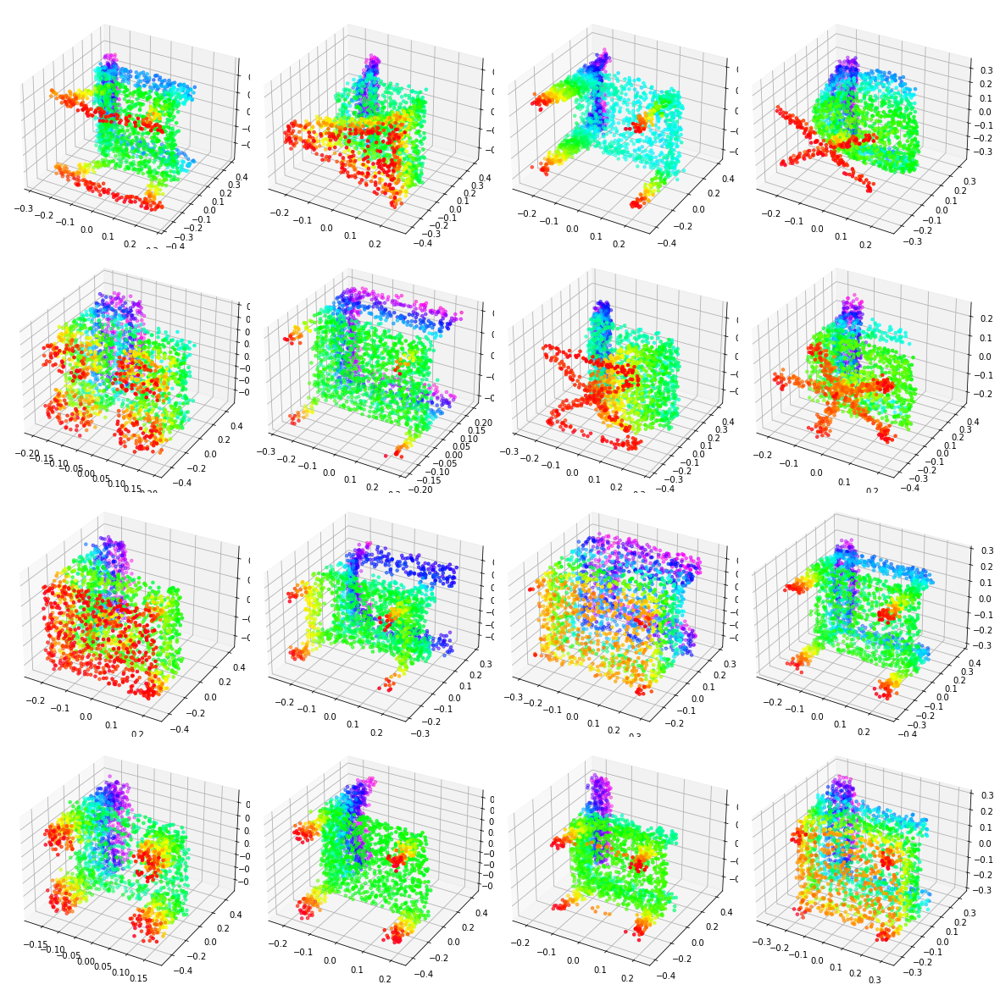

In [14]:
%matplotlib inline
show_point_clouds(x[10:])

In [15]:
net = NetWrapper()

if torch.cuda.is_available():
    net = net.cuda()
    
# set_gpu(args.device)
set_cuda(deterministic=gpu_deterministic)
set_seed(123)

In [16]:
optE = torch.optim.Adam(net.netE.parameters(), lr=1e-3, weight_decay=e_decay, betas=(e_beta1, e_beta2))
optG = torch.optim.Adam(net.netG.parameters(), lr=1e-3, weight_decay=g_decay, betas=(g_beta1, g_beta2))

lr_scheduleE = torch.optim.lr_scheduler.ExponentialLR(optE, e_gamma)
lr_scheduleG = torch.optim.lr_scheduler.ExponentialLR(optG, g_gamma)

In [18]:
total_step = 0

  0%|          | 0/100 [00:00<?, ?it/s]

0 0/400 15/121 
loss_g= 1.28716, 
loss_e= 0.01389, 
en_pos=[ -0.14075,  -0.15121,  -0.01046], 
en_neg=[ -0.15465,  -0.14472,   0.00992], 
|z_g_0|=45.289, 
|z_g_k|=46.747, 
|z_e_0|=45.155, 
|z_e_k|=46.695, 
z_e_disp=64.944, 
z_g_disp=64.973, 
x_e_disp= 0.547, 
prior_moments=[   -0.00,     1.03,     4.72], 
posterior_moments=[    0.00,     1.03,     4.96], 



 ---------------------
0 0/400 30/121 
loss_g= 0.45381, 
loss_e=-0.01277, 
en_pos=[ -0.15677,  -0.16676,  -0.00999], 
en_neg=[ -0.14400,  -0.13367,   0.01033], 
|z_g_0|=45.292, 
|z_g_k|=46.662, 
|z_e_0|=45.361, 
|z_e_k|=46.802, 
z_e_disp=65.280, 
z_g_disp=64.949, 
x_e_disp= 0.708, 
prior_moments=[    0.00,     1.03,     4.65], 
posterior_moments=[    0.00,     1.03,     4.93], 



 ---------------------
0 0/400 45/121 
loss_g= 0.22873, 
loss_e= 0.01206, 
en_pos=[ -0.13740,  -0.14793,  -0.01053], 
en_neg=[ -0.14946,  -0.14003,   0.00943], 
|z_g_0|=45.208, 
|z_g_k|=46.755, 
|z_e_0|=45.274, 
|z_e_k|=46.529, 
z_e_disp=64.808, 
z_g_disp

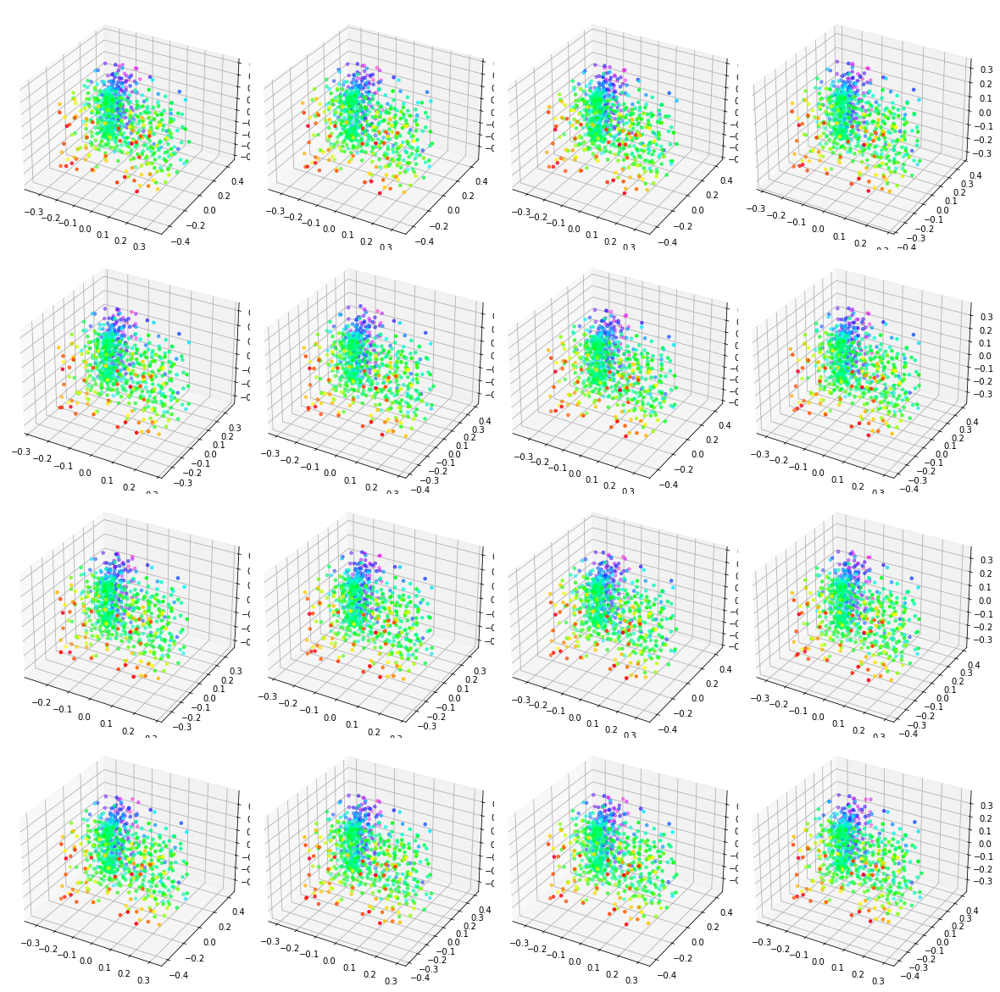

0
0 1/400 135/121 
loss_g= 0.16059, 
loss_e=-0.01232, 
en_pos=[ -0.15822,  -0.16703,  -0.00881], 
en_neg=[ -0.14590,  -0.13680,   0.00910], 
|z_g_0|=45.265, 
|z_g_k|=46.718, 
|z_e_0|=45.253, 
|z_e_k|=46.576, 
z_e_disp=64.874, 
z_g_disp=65.054, 
x_e_disp= 0.831, 
prior_moments=[    0.01,     1.03,     5.00], 
posterior_moments=[    0.01,     1.03,     4.20], 



 ---------------------
0 1/400 150/121 
loss_g= 0.15124, 
loss_e= 0.00480, 
en_pos=[ -0.14975,  -0.15871,  -0.00896], 
en_neg=[ -0.15455,  -0.14546,   0.00909], 
|z_g_0|=45.328, 
|z_g_k|=46.882, 
|z_e_0|=45.315, 
|z_e_k|=46.718, 
z_e_disp=65.024, 
z_g_disp=65.137, 
x_e_disp= 0.911, 
prior_moments=[   -0.01,     1.03,     4.61], 
posterior_moments=[    0.00,     1.04,     5.16], 



 ---------------------
0 1/400 165/121 
loss_g= 0.17509, 
loss_e=-0.00649, 
en_pos=[ -0.15411,  -0.16349,  -0.00939], 
en_neg=[ -0.14762,  -0.13823,   0.00939], 
|z_g_0|=45.134, 
|z_g_k|=46.778, 
|z_e_0|=45.177, 
|z_e_k|=47.077, 
z_e_disp=65.221, 
z_g

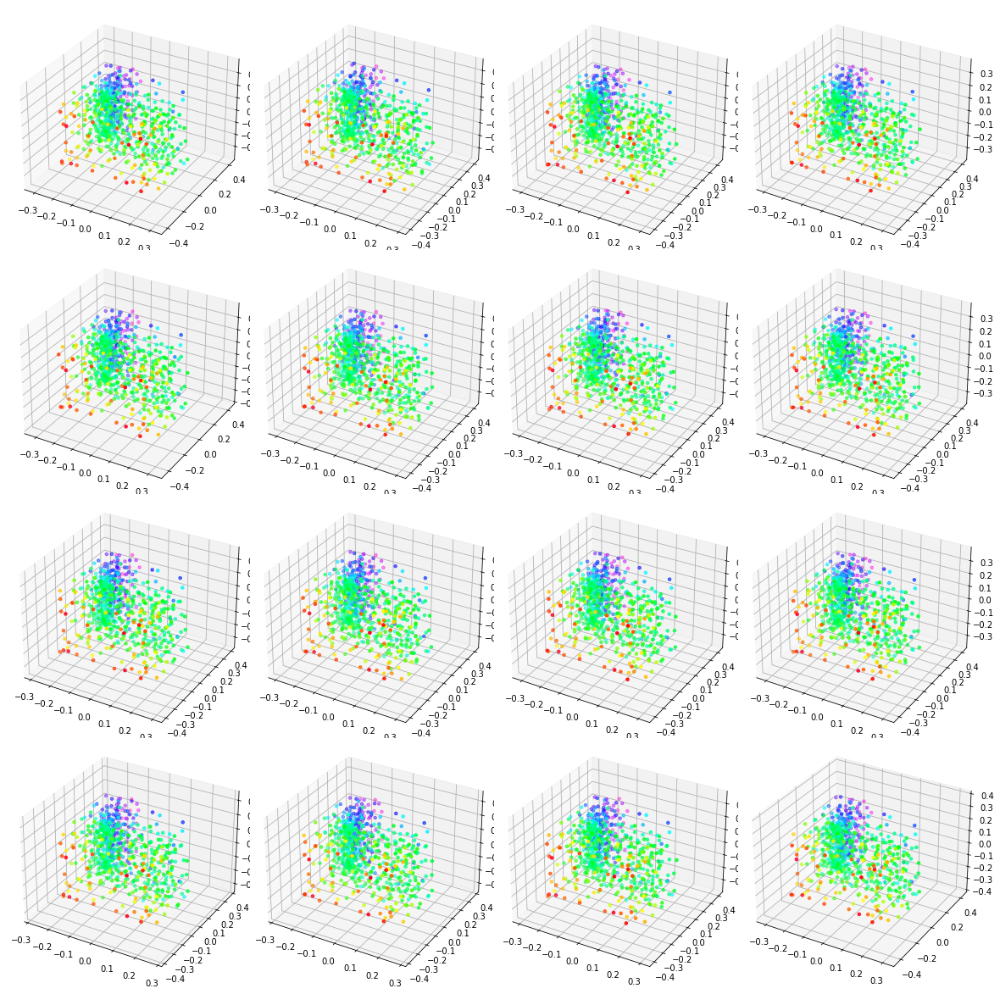

1
0 2/400 255/121 
loss_g= 0.16124, 
loss_e=-0.02361, 
en_pos=[ -0.16070,  -0.16986,  -0.00916], 
en_neg=[ -0.13709,  -0.12769,   0.00940], 
|z_g_0|=45.327, 
|z_g_k|=46.901, 
|z_e_0|=45.238, 
|z_e_k|=46.778, 
z_e_disp=64.973, 
z_g_disp=65.189, 
x_e_disp= 0.692, 
prior_moments=[    0.00,     1.03,     4.60], 
posterior_moments=[   -0.00,     1.04,     4.76], 



 ---------------------
0 2/400 270/121 
loss_g= 0.19401, 
loss_e= 0.02223, 
en_pos=[ -0.14973,  -0.15896,  -0.00924], 
en_neg=[ -0.17195,  -0.16295,   0.00901], 
|z_g_0|=45.342, 
|z_g_k|=46.681, 
|z_e_0|=45.365, 
|z_e_k|=46.890, 
z_e_disp=65.071, 
z_g_disp=64.839, 
x_e_disp= 0.659, 
prior_moments=[   -0.00,     1.04,     4.86], 
posterior_moments=[   -0.00,     1.03,     4.56], 



 ---------------------
0 2/400 285/121 
loss_g= 0.14138, 
loss_e=-0.00016, 
en_pos=[ -0.15473,  -0.16365,  -0.00892], 
en_neg=[ -0.15457,  -0.14540,   0.00917], 
|z_g_0|=45.353, 
|z_g_k|=46.622, 
|z_e_0|=45.163, 
|z_e_k|=46.909, 
z_e_disp=65.299, 
z_g

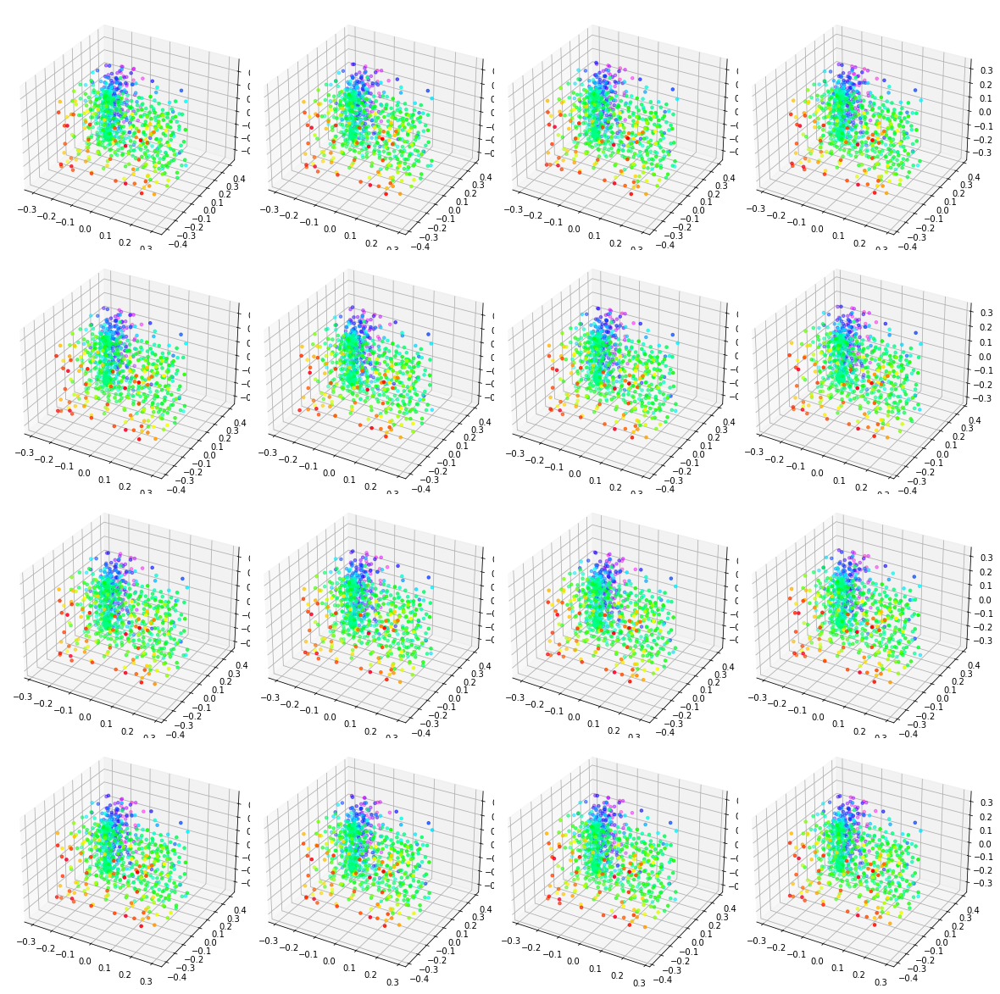

2
0 3/400 375/121 
loss_g= 0.14903, 
loss_e= 0.02440, 
en_pos=[ -0.14035,  -0.14953,  -0.00918], 
en_neg=[ -0.16475,  -0.15603,   0.00872], 
|z_g_0|=45.371, 
|z_g_k|=46.704, 
|z_e_0|=45.309, 
|z_e_k|=46.662, 
z_e_disp=65.063, 
z_g_disp=64.963, 
x_e_disp= 0.550, 
prior_moments=[    0.00,     1.03,     4.68], 
posterior_moments=[    0.00,     1.03,     4.79], 



 ---------------------
0 3/400 390/121 
loss_g= 0.15598, 
loss_e= 0.00756, 
en_pos=[ -0.14146,  -0.15036,  -0.00891], 
en_neg=[ -0.14901,  -0.13954,   0.00947], 
|z_g_0|=45.198, 
|z_g_k|=46.699, 
|z_e_0|=45.125, 
|z_e_k|=46.840, 
z_e_disp=65.156, 
z_g_disp=64.856, 
x_e_disp= 0.571, 
prior_moments=[   -0.00,     1.04,     4.50], 
posterior_moments=[    0.00,     1.03,     4.85], 



 ---------------------
0 3/400 405/121 
loss_g= 0.18114, 
loss_e=-0.01133, 
en_pos=[ -0.15177,  -0.16128,  -0.00951], 
en_neg=[ -0.14045,  -0.13164,   0.00880], 
|z_g_0|=45.307, 
|z_g_k|=46.543, 
|z_e_0|=45.251, 
|z_e_k|=46.740, 
z_e_disp=64.934, 
z_g

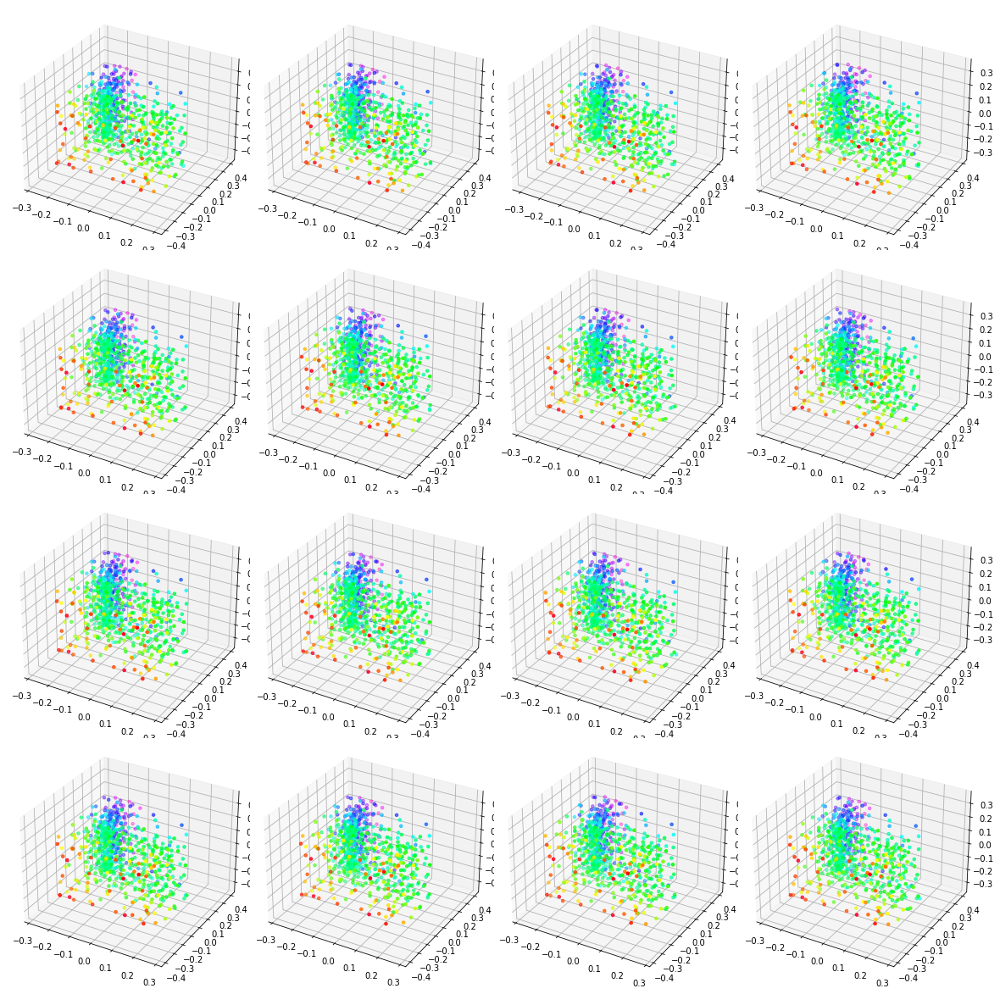

3
0 4/400 495/121 
loss_g= 0.15953, 
loss_e=-0.01698, 
en_pos=[ -0.15774,  -0.16632,  -0.00858], 
en_neg=[ -0.14077,  -0.13121,   0.00956], 
|z_g_0|=45.239, 
|z_g_k|=46.603, 
|z_e_0|=45.208, 
|z_e_k|=46.741, 
z_e_disp=65.129, 
z_g_disp=64.750, 
x_e_disp= 0.526, 
prior_moments=[    0.01,     1.03,     5.35], 
posterior_moments=[    0.00,     1.03,     4.96], 



 ---------------------
0 4/400 510/121 
loss_g= 0.17363, 
loss_e= 0.00662, 
en_pos=[ -0.13635,  -0.14600,  -0.00966], 
en_neg=[ -0.14297,  -0.13407,   0.00890], 
|z_g_0|=45.249, 
|z_g_k|=46.939, 
|z_e_0|=45.230, 
|z_e_k|=46.837, 
z_e_disp=65.144, 
z_g_disp=65.106, 
x_e_disp= 0.531, 
prior_moments=[    0.00,     1.04,     4.76], 
posterior_moments=[    0.00,     1.04,     4.47], 



 ---------------------
0 4/400 525/121 
loss_g= 0.15784, 
loss_e=-0.00168, 
en_pos=[ -0.15276,  -0.16169,  -0.00893], 
en_neg=[ -0.15109,  -0.14169,   0.00939], 
|z_g_0|=45.184, 
|z_g_k|=46.801, 
|z_e_0|=45.337, 
|z_e_k|=46.773, 
z_e_disp=65.067, 
z_g

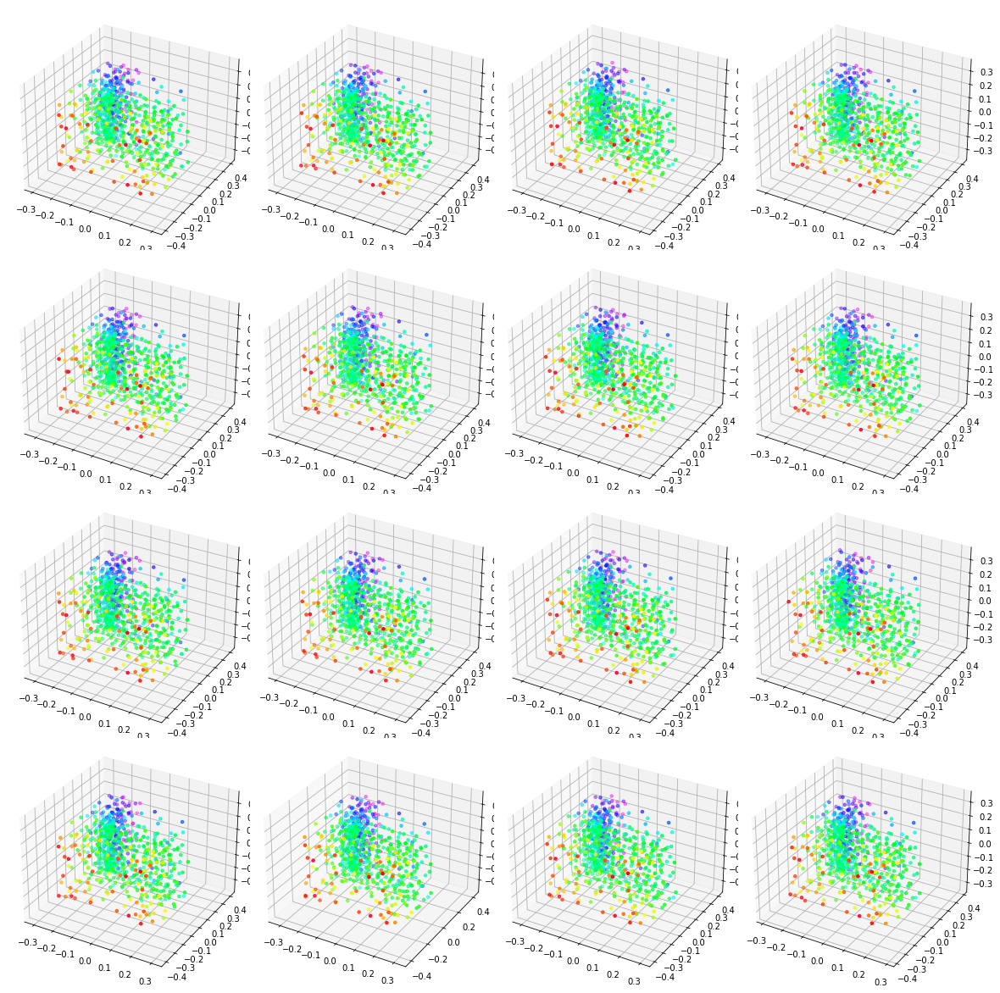

4
0 5/400 615/121 
loss_g= 0.14345, 
loss_e= 0.00643, 
en_pos=[ -0.14655,  -0.15568,  -0.00912], 
en_neg=[ -0.15298,  -0.14455,   0.00843], 
|z_g_0|=45.191, 
|z_g_k|=46.651, 
|z_e_0|=45.263, 
|z_e_k|=46.655, 
z_e_disp=64.959, 
z_g_disp=64.632, 
x_e_disp= 0.476, 
prior_moments=[    0.00,     1.03,     4.53], 
posterior_moments=[    0.00,     1.03,     4.69], 



 ---------------------
0 5/400 630/121 
loss_g= 0.19790, 
loss_e= 0.02498, 
en_pos=[ -0.13399,  -0.14284,  -0.00884], 
en_neg=[ -0.15898,  -0.14996,   0.00902], 
|z_g_0|=45.285, 
|z_g_k|=46.766, 
|z_e_0|=45.273, 
|z_e_k|=46.799, 
z_e_disp=65.153, 
z_g_disp=64.859, 
x_e_disp= 0.511, 
prior_moments=[   -0.00,     1.03,     4.57], 
posterior_moments=[    0.01,     1.03,     4.44], 



 ---------------------
0 5/400 645/121 
loss_g= 0.14958, 
loss_e= 0.01005, 
en_pos=[ -0.15733,  -0.16626,  -0.00893], 
en_neg=[ -0.16738,  -0.15830,   0.00908], 
|z_g_0|=45.330, 
|z_g_k|=46.629, 
|z_e_0|=45.111, 
|z_e_k|=46.657, 
z_e_disp=64.911, 
z_g

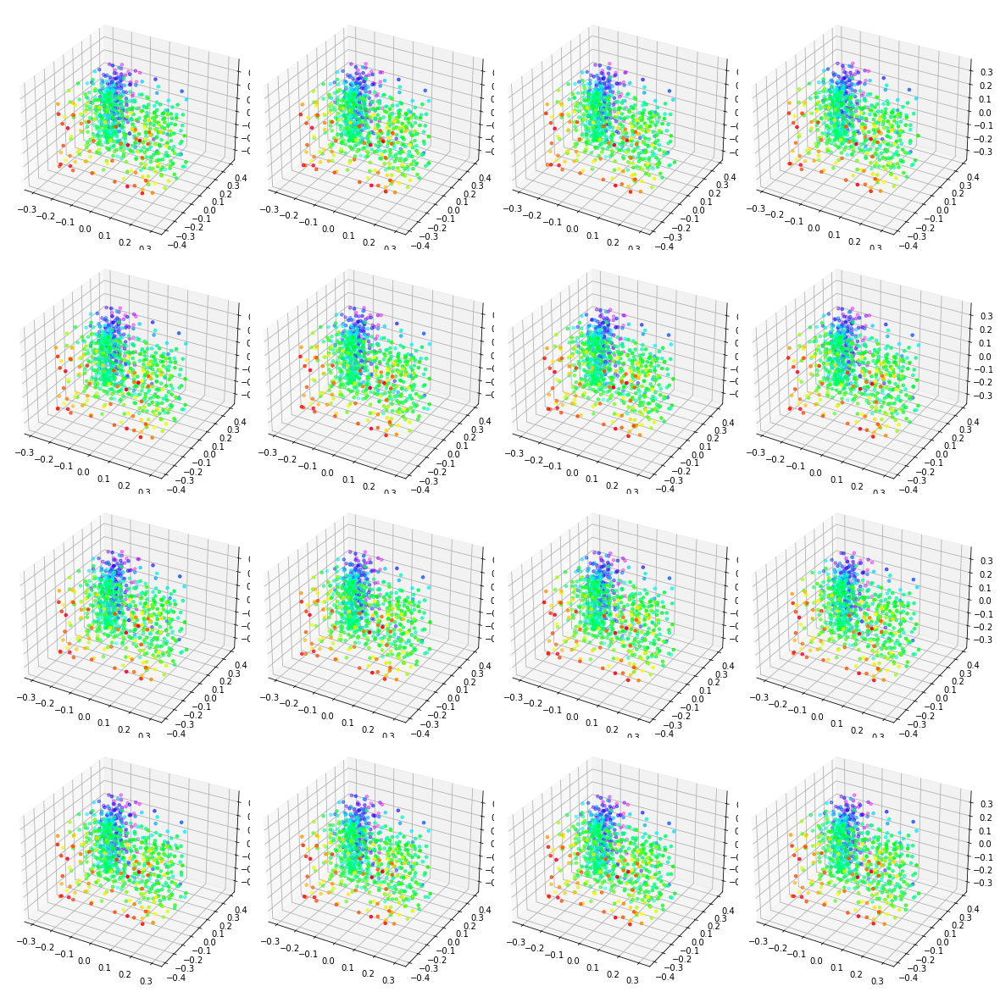

5
0 6/400 735/121 
loss_g= 0.15442, 
loss_e= 0.00884, 
en_pos=[ -0.13989,  -0.14880,  -0.00892], 
en_neg=[ -0.14872,  -0.13970,   0.00903], 
|z_g_0|=45.131, 
|z_g_k|=46.647, 
|z_e_0|=45.179, 
|z_e_k|=46.706, 
z_e_disp=64.965, 
z_g_disp=64.668, 
x_e_disp= 0.470, 
prior_moments=[   -0.00,     1.03,     4.57], 
posterior_moments=[    0.00,     1.03,     4.88], 



 ---------------------
0 6/400 750/121 
loss_g= 0.15591, 
loss_e= 0.00045, 
en_pos=[ -0.13411,  -0.14325,  -0.00914], 
en_neg=[ -0.13456,  -0.12571,   0.00885], 
|z_g_0|=45.221, 
|z_g_k|=46.833, 
|z_e_0|=45.264, 
|z_e_k|=46.687, 
z_e_disp=65.032, 
z_g_disp=65.003, 
x_e_disp= 0.462, 
prior_moments=[   -0.00,     1.03,     4.74], 
posterior_moments=[    0.00,     1.04,     5.45], 



 ---------------------
0 6/400 765/121 
loss_g= 0.18364, 
loss_e=-0.00542, 
en_pos=[ -0.14669,  -0.15582,  -0.00913], 
en_neg=[ -0.14127,  -0.13167,   0.00960], 
|z_g_0|=45.164, 
|z_g_k|=46.607, 
|z_e_0|=45.129, 
|z_e_k|=46.669, 
z_e_disp=64.941, 
z_g

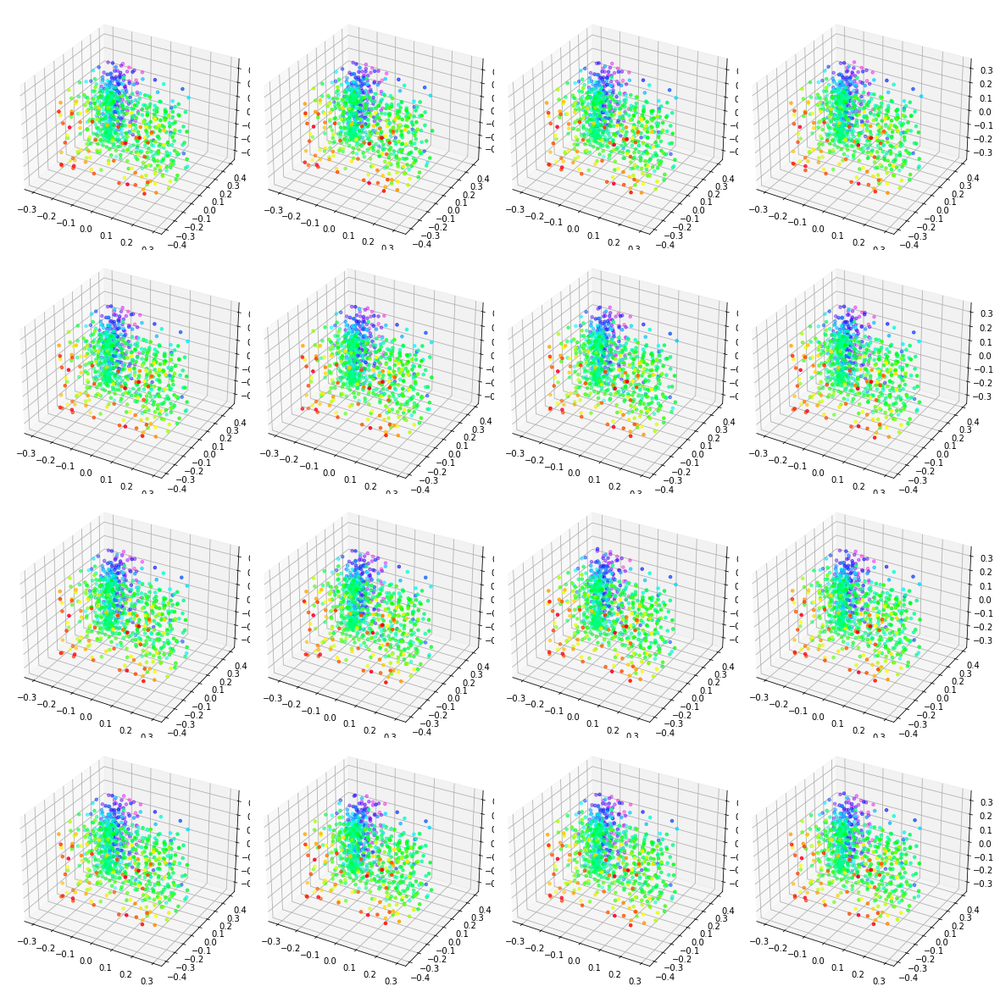

6
0 7/400 855/121 
loss_g= 0.20004, 
loss_e=-0.00261, 
en_pos=[ -0.17464,  -0.18356,  -0.00892], 
en_neg=[ -0.17203,  -0.16320,   0.00883], 
|z_g_0|=45.203, 
|z_g_k|=46.699, 
|z_e_0|=45.188, 
|z_e_k|=46.817, 
z_e_disp=64.937, 
z_g_disp=64.938, 
x_e_disp= 0.461, 
prior_moments=[   -0.00,     1.03,     4.26], 
posterior_moments=[    0.00,     1.03,     4.49], 



 ---------------------
0 7/400 870/121 
loss_g= 0.13968, 
loss_e= 0.00615, 
en_pos=[ -0.15260,  -0.16172,  -0.00912], 
en_neg=[ -0.15875,  -0.14966,   0.00909], 
|z_g_0|=45.228, 
|z_g_k|=46.963, 
|z_e_0|=45.207, 
|z_e_k|=46.653, 
z_e_disp=64.853, 
z_g_disp=64.901, 
x_e_disp= 0.437, 
prior_moments=[   -0.00,     1.03,     4.59], 
posterior_moments=[    0.01,     1.04,     4.59], 



 ---------------------
0 7/400 885/121 
loss_g= 0.17884, 
loss_e=-0.00740, 
en_pos=[ -0.16615,  -0.17526,  -0.00911], 
en_neg=[ -0.15876,  -0.14970,   0.00906], 
|z_g_0|=45.339, 
|z_g_k|=46.950, 
|z_e_0|=45.141, 
|z_e_k|=46.541, 
z_e_disp=64.692, 
z_g

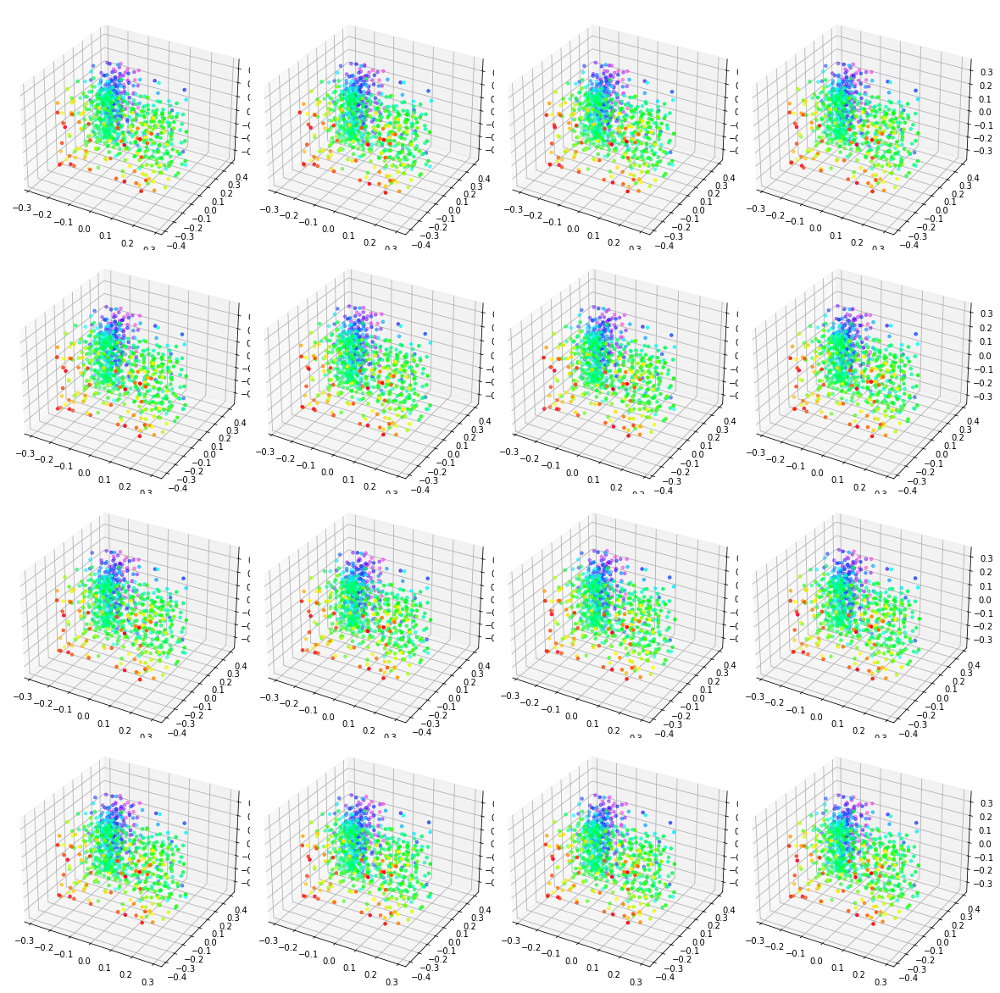

7
0 8/400 975/121 
loss_g= 0.17189, 
loss_e=-0.00804, 
en_pos=[ -0.16667,  -0.17532,  -0.00865], 
en_neg=[ -0.15863,  -0.14973,   0.00890], 
|z_g_0|=45.209, 
|z_g_k|=46.559, 
|z_e_0|=45.238, 
|z_e_k|=46.843, 
z_e_disp=64.996, 
z_g_disp=64.636, 
x_e_disp= 0.454, 
prior_moments=[   -0.00,     1.04,     4.93], 
posterior_moments=[    0.00,     1.03,     4.33], 



 ---------------------
0 8/400 990/121 
loss_g= 0.16056, 
loss_e=-0.01220, 
en_pos=[ -0.15510,  -0.16403,  -0.00892], 
en_neg=[ -0.14290,  -0.13340,   0.00951], 
|z_g_0|=45.306, 
|z_g_k|=46.747, 
|z_e_0|=45.267, 
|z_e_k|=46.692, 
z_e_disp=64.896, 
z_g_disp=65.111, 
x_e_disp= 0.426, 
prior_moments=[    0.00,     1.03,     4.62], 
posterior_moments=[   -0.00,     1.03,     4.44], 



 ---------------------
0 8/400 1005/121 
loss_g= 0.14968, 
loss_e=-0.02202, 
en_pos=[ -0.16762,  -0.17595,  -0.00833], 
en_neg=[ -0.14560,  -0.13680,   0.00880], 
|z_g_0|=45.251, 
|z_g_k|=46.648, 
|z_e_0|=45.115, 
|z_e_k|=46.854, 
z_e_disp=64.903, 
z_

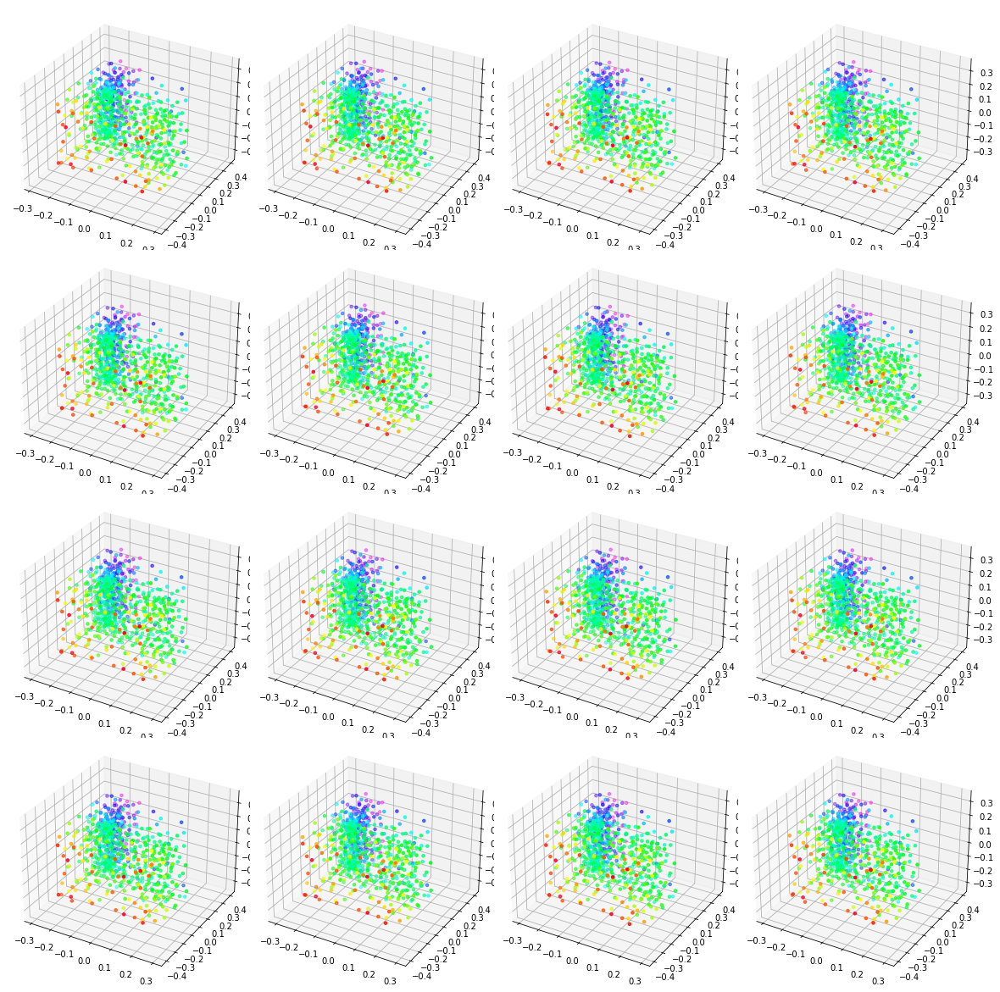

8
0 9/400 1095/121 
loss_g= 0.18068, 
loss_e= 0.00726, 
en_pos=[ -0.14829,  -0.15775,  -0.00946], 
en_neg=[ -0.15555,  -0.14651,   0.00905], 
|z_g_0|=45.462, 
|z_g_k|=46.783, 
|z_e_0|=45.155, 
|z_e_k|=46.664, 
z_e_disp=64.885, 
z_g_disp=64.986, 
x_e_disp= 0.412, 
prior_moments=[    0.01,     1.03,     5.16], 
posterior_moments=[   -0.00,     1.03,     4.87], 



 ---------------------
0 9/400 1110/121 
loss_g= 0.17198, 
loss_e= 0.00799, 
en_pos=[ -0.15554,  -0.16467,  -0.00912], 
en_neg=[ -0.16353,  -0.15464,   0.00890], 
|z_g_0|=45.362, 
|z_g_k|=46.813, 
|z_e_0|=45.450, 
|z_e_k|=46.726, 
z_e_disp=65.086, 
z_g_disp=64.952, 
x_e_disp= 0.427, 
prior_moments=[   -0.00,     1.03,     4.90], 
posterior_moments=[   -0.00,     1.03,     4.57], 



 ---------------------
0 9/400 1125/121 
loss_g= 0.17503, 
loss_e=-0.01604, 
en_pos=[ -0.15647,  -0.16485,  -0.00837], 
en_neg=[ -0.14044,  -0.13090,   0.00953], 
|z_g_0|=45.137, 
|z_g_k|=46.714, 
|z_e_0|=45.389, 
|z_e_k|=46.857, 
z_e_disp=65.229, 


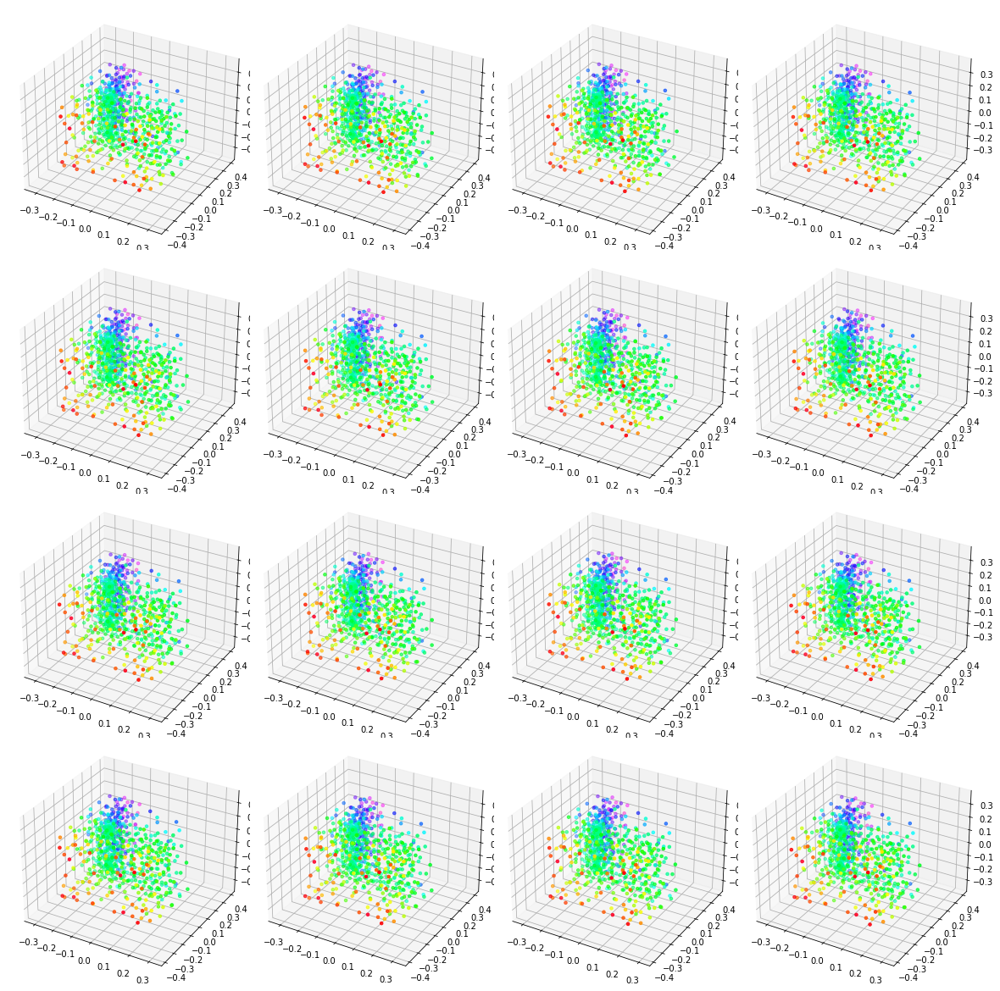

9
0 10/400 1215/121 
loss_g= 0.17110, 
loss_e= 0.01302, 
en_pos=[ -0.15108,  -0.16035,  -0.00927], 
en_neg=[ -0.16410,  -0.15523,   0.00887], 
|z_g_0|=45.165, 
|z_g_k|=46.711, 
|z_e_0|=45.442, 
|z_e_k|=46.897, 
z_e_disp=65.292, 
z_g_disp=64.887, 
x_e_disp= 0.419, 
prior_moments=[    0.00,     1.04,     5.54], 
posterior_moments=[   -0.00,     1.03,     4.81], 



 ---------------------
0 10/400 1230/121 
loss_g= 0.16343, 
loss_e=-0.01691, 
en_pos=[ -0.15476,  -0.16410,  -0.00933], 
en_neg=[ -0.13785,  -0.12888,   0.00897], 
|z_g_0|=45.156, 
|z_g_k|=46.770, 
|z_e_0|=45.347, 
|z_e_k|=46.797, 
z_e_disp=65.007, 
z_g_disp=64.998, 
x_e_disp= 0.395, 
prior_moments=[   -0.00,     1.03,     4.96], 
posterior_moments=[    0.00,     1.03,     4.67], 



 ---------------------
0 10/400 1245/121 
loss_g= 0.18650, 
loss_e=-0.01063, 
en_pos=[ -0.16179,  -0.17119,  -0.00940], 
en_neg=[ -0.15116,  -0.14244,   0.00872], 
|z_g_0|=45.265, 
|z_g_k|=46.849, 
|z_e_0|=45.342, 
|z_e_k|=46.589, 
z_e_disp=65.089

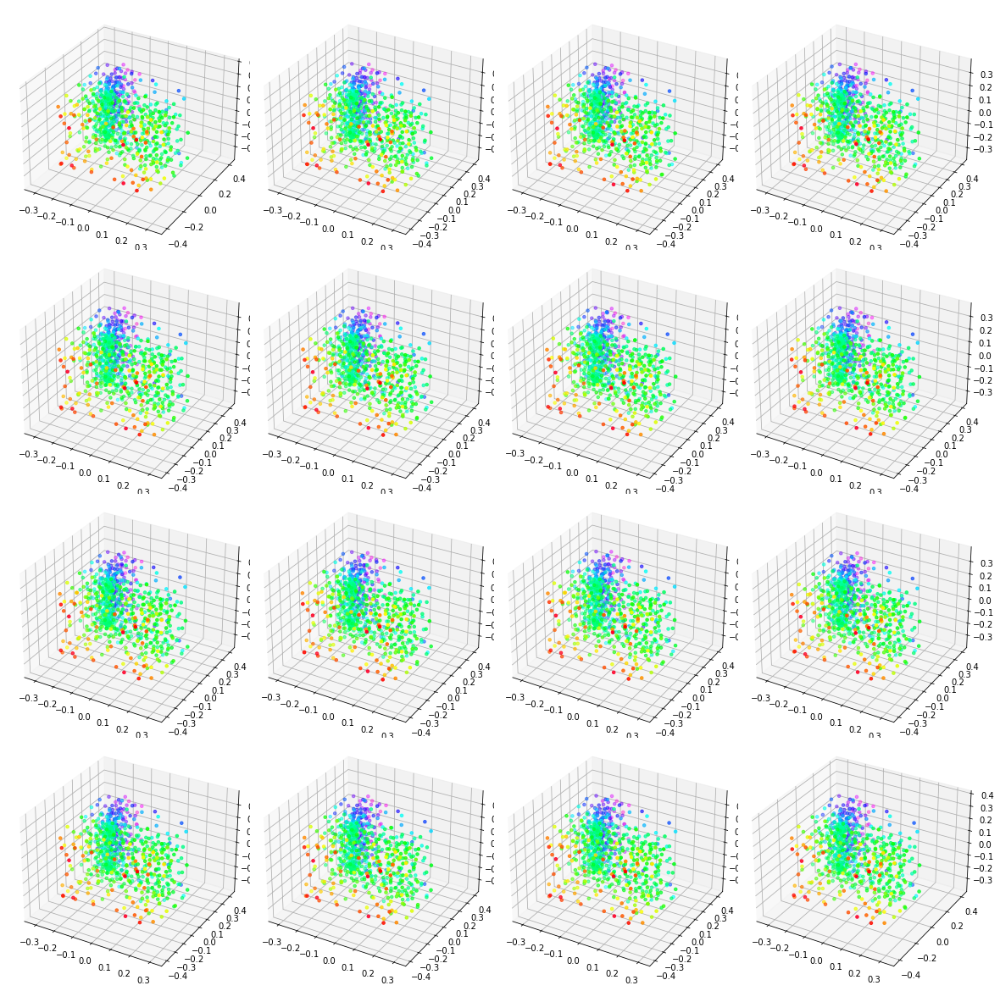

10
0 11/400 1335/121 
loss_g= 0.15181, 
loss_e=-0.01760, 
en_pos=[ -0.16661,  -0.17547,  -0.00886], 
en_neg=[ -0.14901,  -0.13967,   0.00934], 
|z_g_0|=45.306, 
|z_g_k|=46.562, 
|z_e_0|=45.203, 
|z_e_k|=46.614, 
z_e_disp=64.857, 
z_g_disp=64.866, 
x_e_disp= 0.385, 
prior_moments=[   -0.01,     1.03,     4.58], 
posterior_moments=[    0.00,     1.03,     4.56], 



 ---------------------
0 11/400 1350/121 
loss_g= 0.14990, 
loss_e= 0.00183, 
en_pos=[ -0.14304,  -0.15229,  -0.00925], 
en_neg=[ -0.14487,  -0.13606,   0.00882], 
|z_g_0|=45.166, 
|z_g_k|=46.781, 
|z_e_0|=45.427, 
|z_e_k|=46.622, 
z_e_disp=65.186, 
z_g_disp=64.919, 
x_e_disp= 0.375, 
prior_moments=[   -0.00,     1.03,     4.51], 
posterior_moments=[    0.00,     1.03,     4.85], 



 ---------------------
0 11/400 1365/121 
loss_g= 0.18540, 
loss_e=-0.01361, 
en_pos=[ -0.16025,  -0.16952,  -0.00927], 
en_neg=[ -0.14664,  -0.13795,   0.00870], 
|z_g_0|=45.383, 
|z_g_k|=46.748, 
|z_e_0|=45.152, 
|z_e_k|=46.677, 
z_e_disp=64.87

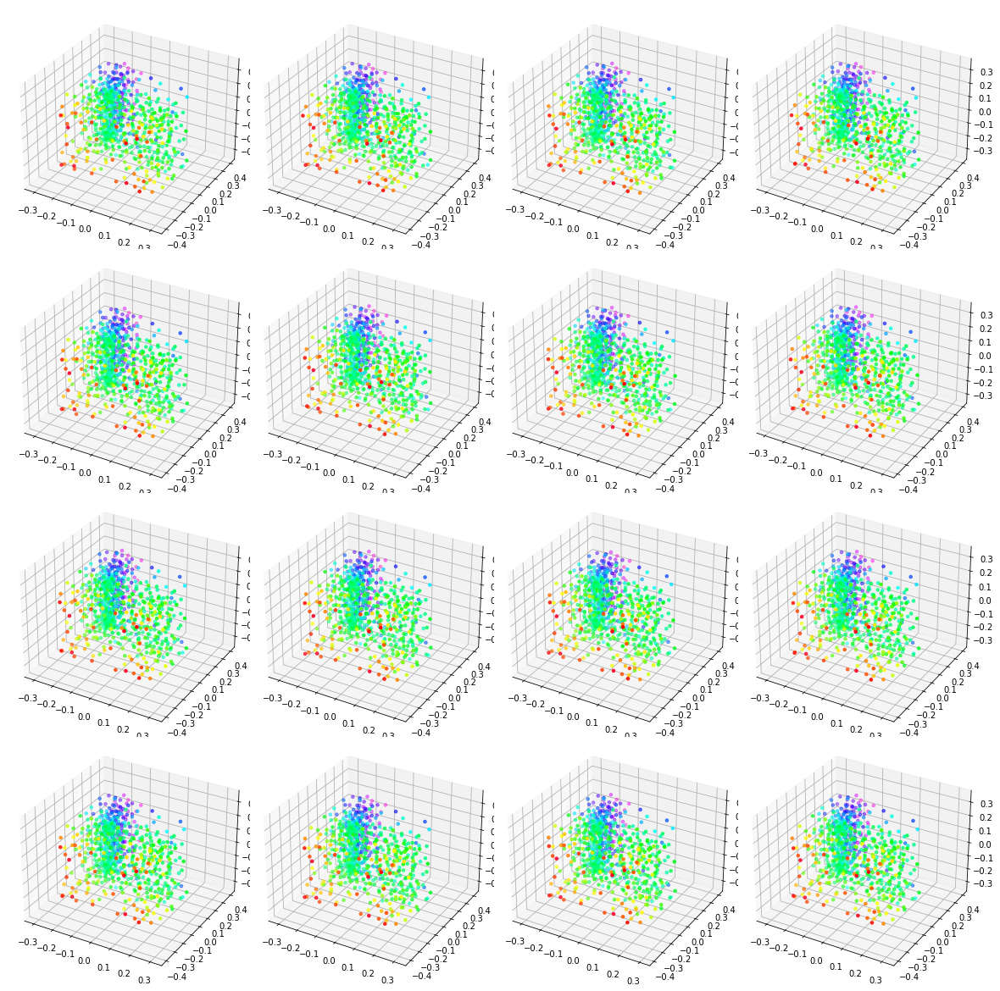

11
0 12/400 1455/121 
loss_g= 0.16216, 
loss_e= 0.04983, 
en_pos=[ -0.13677,  -0.14578,  -0.00901], 
en_neg=[ -0.18659,  -0.17779,   0.00880], 
|z_g_0|=45.275, 
|z_g_k|=46.699, 
|z_e_0|=45.218, 
|z_e_k|=46.701, 
z_e_disp=64.923, 
z_g_disp=64.998, 
x_e_disp= 0.366, 
prior_moments=[    0.00,     1.03,     5.04], 
posterior_moments=[    0.00,     1.03,     4.87], 



 ---------------------
0 12/400 1470/121 
loss_g= 0.19007, 
loss_e=-0.00802, 
en_pos=[ -0.15329,  -0.16229,  -0.00900], 
en_neg=[ -0.14527,  -0.13637,   0.00890], 
|z_g_0|=45.275, 
|z_g_k|=46.837, 
|z_e_0|=45.367, 
|z_e_k|=46.685, 
z_e_disp=65.082, 
z_g_disp=65.053, 
x_e_disp= 0.379, 
prior_moments=[   -0.00,     1.03,     4.78], 
posterior_moments=[   -0.00,     1.04,     4.42], 



 ---------------------
0 12/400 1485/121 
loss_g= 0.12573, 
loss_e=-0.00710, 
en_pos=[ -0.16319,  -0.17254,  -0.00935], 
en_neg=[ -0.15609,  -0.14809,   0.00800], 
|z_g_0|=45.446, 
|z_g_k|=46.744, 
|z_e_0|=45.366, 
|z_e_k|=46.639, 
z_e_disp=64.90

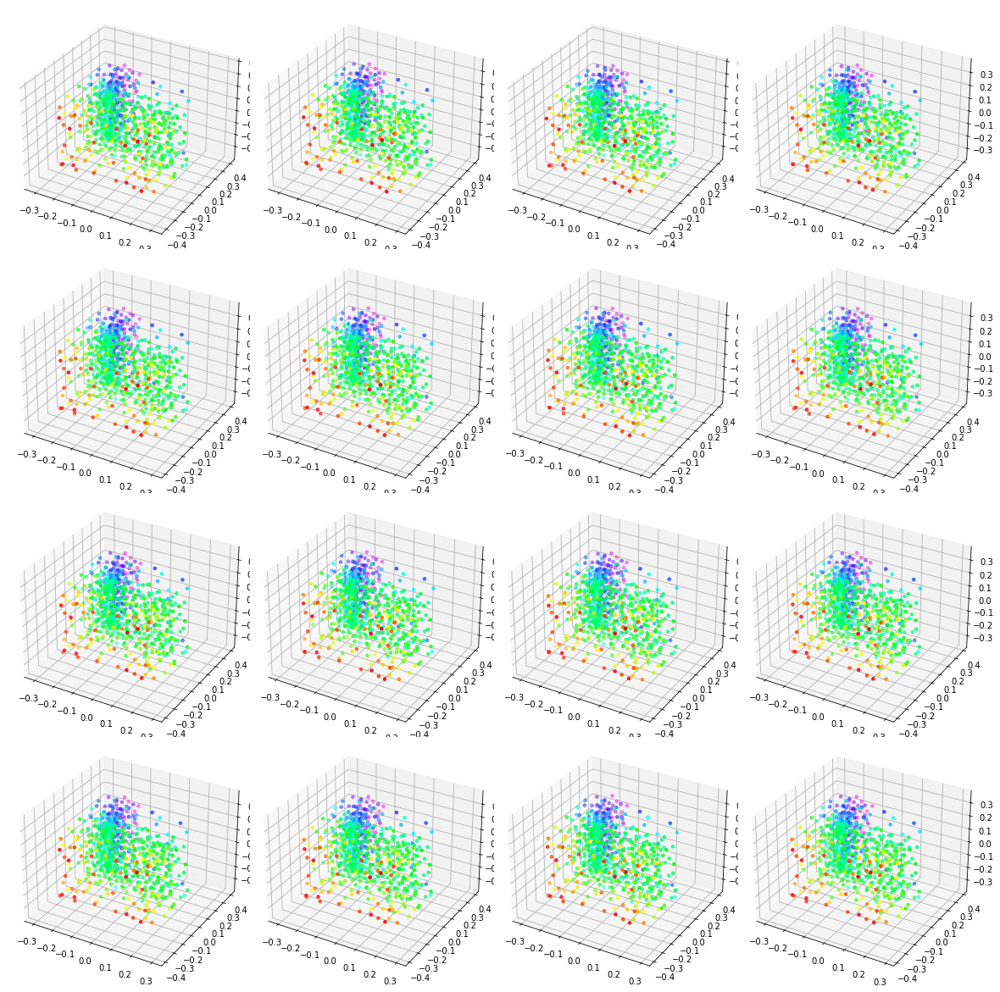

12
0 13/400 1575/121 
loss_g= 0.16996, 
loss_e= 0.01318, 
en_pos=[ -0.13930,  -0.14816,  -0.00887], 
en_neg=[ -0.15248,  -0.14315,   0.00933], 
|z_g_0|=45.233, 
|z_g_k|=46.888, 
|z_e_0|=45.310, 
|z_e_k|=46.891, 
z_e_disp=65.284, 
z_g_disp=65.018, 
x_e_disp= 0.391, 
prior_moments=[    0.01,     1.04,     4.31], 
posterior_moments=[   -0.00,     1.04,     4.79], 



 ---------------------
0 13/400 1590/121 
loss_g= 0.12987, 
loss_e=-0.01047, 
en_pos=[ -0.15260,  -0.16214,  -0.00954], 
en_neg=[ -0.14213,  -0.13349,   0.00865], 
|z_g_0|=45.256, 
|z_g_k|=46.923, 
|z_e_0|=45.270, 
|z_e_k|=46.874, 
z_e_disp=65.086, 
z_g_disp=65.156, 
x_e_disp= 0.380, 
prior_moments=[   -0.00,     1.04,     5.01], 
posterior_moments=[   -0.00,     1.04,     5.33], 



 ---------------------
0 13/400 1605/121 
loss_g= 0.16913, 
loss_e= 0.00335, 
en_pos=[ -0.14155,  -0.15036,  -0.00881], 
en_neg=[ -0.14490,  -0.13623,   0.00867], 
|z_g_0|=45.360, 
|z_g_k|=46.708, 
|z_e_0|=45.181, 
|z_e_k|=46.629, 
z_e_disp=64.78

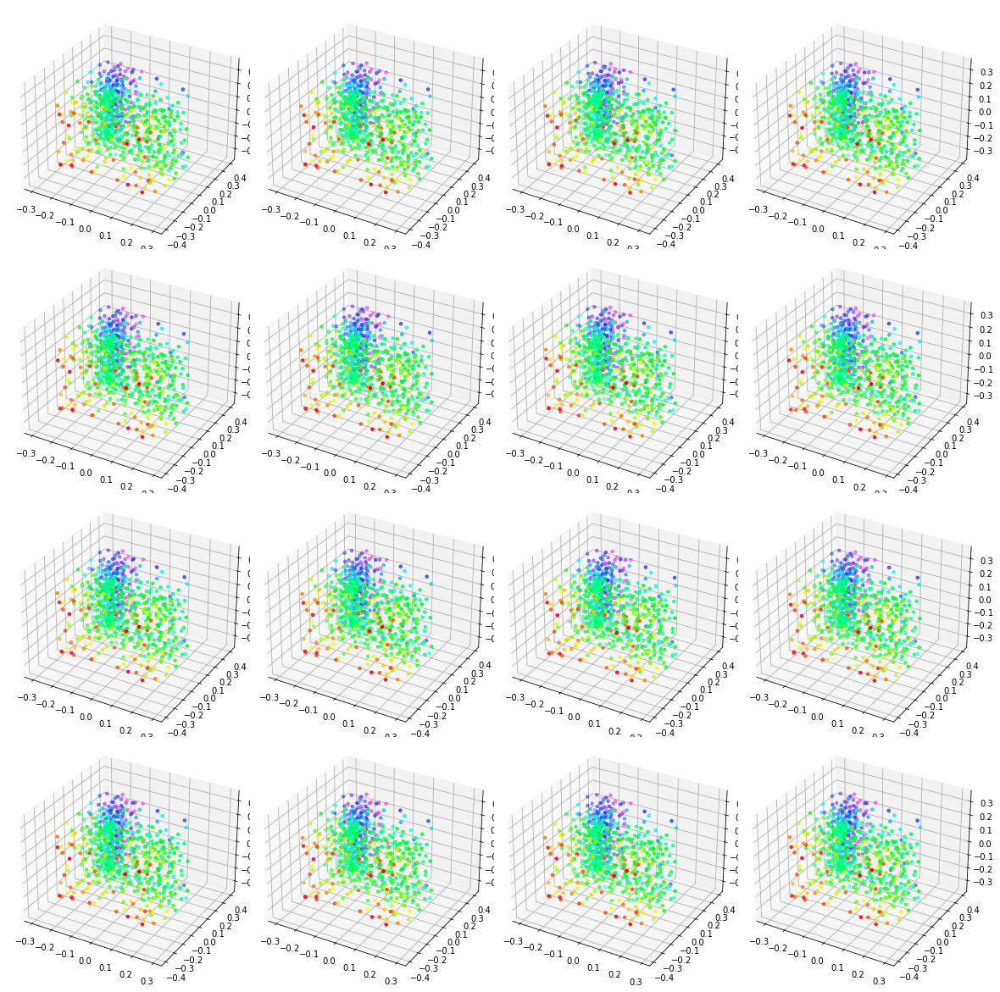

13
0 14/400 1695/121 
loss_g= 0.15643, 
loss_e= 0.00690, 
en_pos=[ -0.16339,  -0.17180,  -0.00841], 
en_neg=[ -0.17029,  -0.16129,   0.00900], 
|z_g_0|=45.196, 
|z_g_k|=46.742, 
|z_e_0|=45.189, 
|z_e_k|=46.925, 
z_e_disp=65.032, 
z_g_disp=64.746, 
x_e_disp= 0.369, 
prior_moments=[   -0.01,     1.04,     4.99], 
posterior_moments=[    0.00,     1.03,     4.67], 



 ---------------------
0 14/400 1710/121 
loss_g= 0.17459, 
loss_e=-0.00628, 
en_pos=[ -0.14980,  -0.15927,  -0.00947], 
en_neg=[ -0.14353,  -0.13465,   0.00888], 
|z_g_0|=45.208, 
|z_g_k|=46.816, 
|z_e_0|=45.224, 
|z_e_k|=46.579, 
z_e_disp=64.839, 
z_g_disp=65.100, 
x_e_disp= 0.371, 
prior_moments=[   -0.00,     1.03,     4.57], 
posterior_moments=[   -0.00,     1.03,     4.66], 



 ---------------------
0 14/400 1725/121 
loss_g= 0.16556, 
loss_e=-0.00831, 
en_pos=[ -0.15924,  -0.16776,  -0.00851], 
en_neg=[ -0.15093,  -0.14188,   0.00905], 
|z_g_0|=45.128, 
|z_g_k|=46.662, 
|z_e_0|=45.124, 
|z_e_k|=46.709, 
z_e_disp=64.91

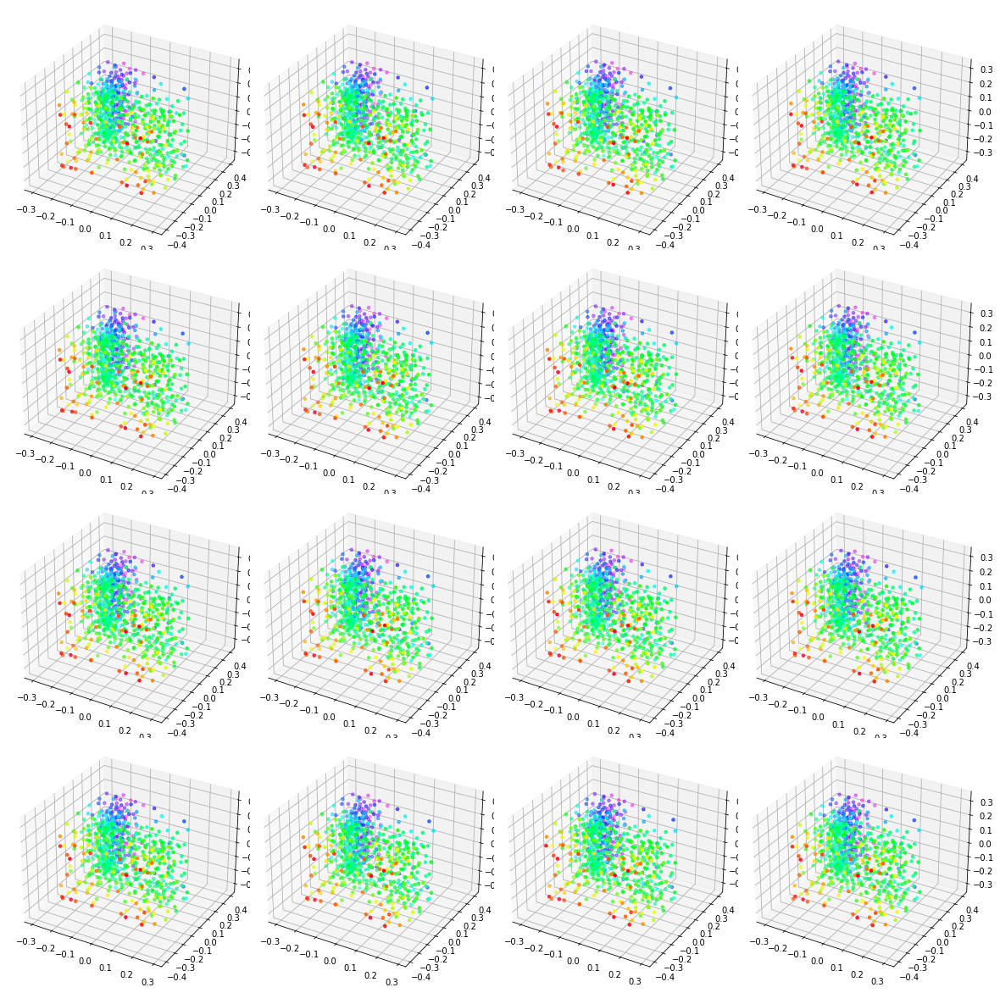

14
0 15/400 1830/121 
loss_g= 0.16579, 
loss_e=-0.04233, 
en_pos=[ -0.18232,  -0.19145,  -0.00913], 
en_neg=[ -0.13999,  -0.13134,   0.00864], 
|z_g_0|=45.230, 
|z_g_k|=46.784, 
|z_e_0|=45.075, 
|z_e_k|=46.604, 
z_e_disp=64.937, 
z_g_disp=65.004, 
x_e_disp= 0.362, 
prior_moments=[    0.00,     1.03,     4.34], 
posterior_moments=[    0.01,     1.03,     4.82], 



 ---------------------
0 15/400 1845/121 
loss_g= 0.16723, 
loss_e= 0.00818, 
en_pos=[ -0.15957,  -0.16859,  -0.00902], 
en_neg=[ -0.16775,  -0.15856,   0.00919], 
|z_g_0|=45.383, 
|z_g_k|=46.664, 
|z_e_0|=45.189, 
|z_e_k|=46.896, 
z_e_disp=65.110, 
z_g_disp=64.896, 
x_e_disp= 0.336, 
prior_moments=[    0.00,     1.04,     4.76], 
posterior_moments=[    0.00,     1.03,     4.70], 



 ---------------------
0 15/400 1860/121 
loss_g= 0.15629, 
loss_e= 0.00057, 
en_pos=[ -0.14729,  -0.15624,  -0.00895], 
en_neg=[ -0.14786,  -0.13878,   0.00908], 
|z_g_0|=45.320, 
|z_g_k|=46.623, 
|z_e_0|=45.117, 
|z_e_k|=46.735, 
z_e_disp=65.01

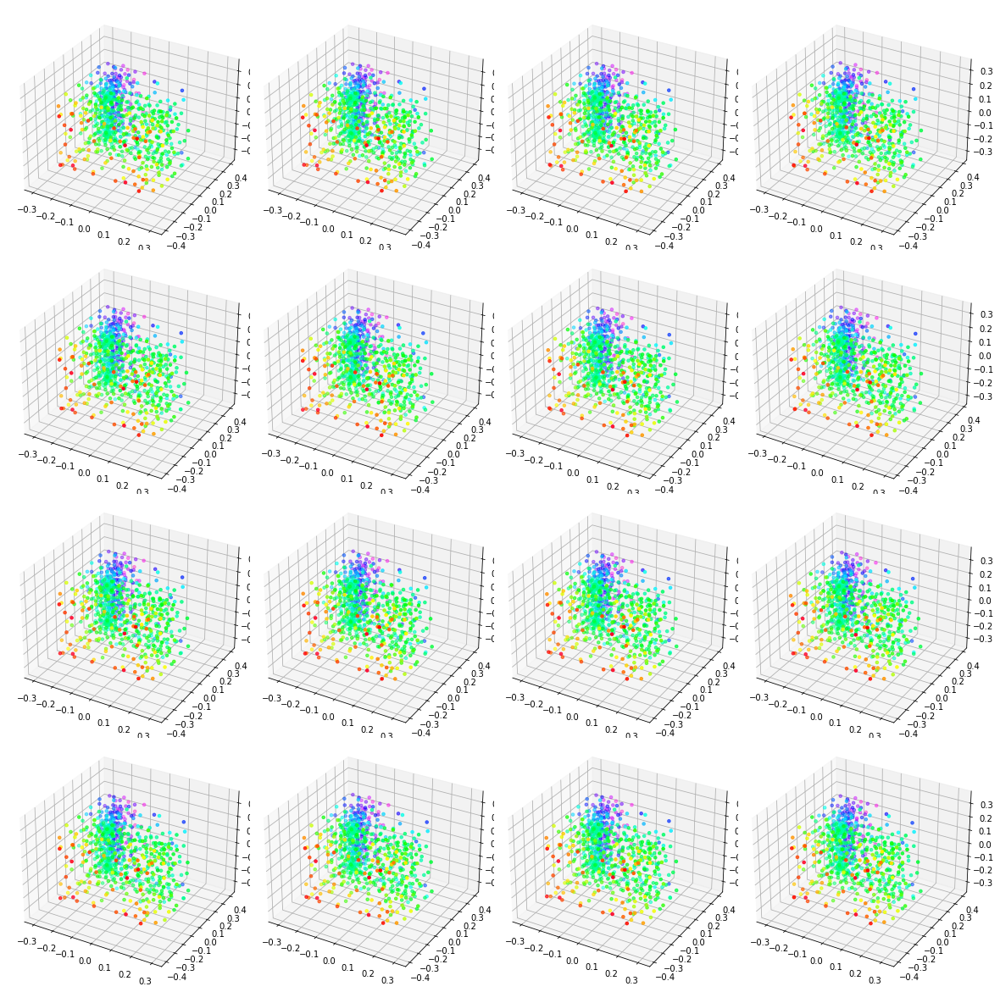

15
0 16/400 1950/121 
loss_g= 0.16230, 
loss_e= 0.01655, 
en_pos=[ -0.13499,  -0.14382,  -0.00883], 
en_neg=[ -0.15154,  -0.14239,   0.00915], 
|z_g_0|=45.483, 
|z_g_k|=46.765, 
|z_e_0|=45.261, 
|z_e_k|=46.904, 
z_e_disp=65.104, 
z_g_disp=65.159, 
x_e_disp= 0.371, 
prior_moments=[    0.01,     1.04,     4.70], 
posterior_moments=[    0.00,     1.03,     4.30], 



 ---------------------
0 16/400 1965/121 
loss_g= 0.15680, 
loss_e= 0.00327, 
en_pos=[ -0.13569,  -0.14435,  -0.00866], 
en_neg=[ -0.13895,  -0.12960,   0.00935], 
|z_g_0|=45.339, 
|z_g_k|=46.737, 
|z_e_0|=45.422, 
|z_e_k|=46.696, 
z_e_disp=65.074, 
z_g_disp=65.028, 
x_e_disp= 0.351, 
prior_moments=[   -0.00,     1.03,     4.21], 
posterior_moments=[    0.00,     1.03,     4.52], 



 ---------------------
0 16/400 1980/121 
loss_g= 0.15117, 
loss_e=-0.02437, 
en_pos=[ -0.15882,  -0.16788,  -0.00906], 
en_neg=[ -0.13445,  -0.12498,   0.00947], 
|z_g_0|=45.357, 
|z_g_k|=46.895, 
|z_e_0|=45.387, 
|z_e_k|=46.689, 
z_e_disp=65.07

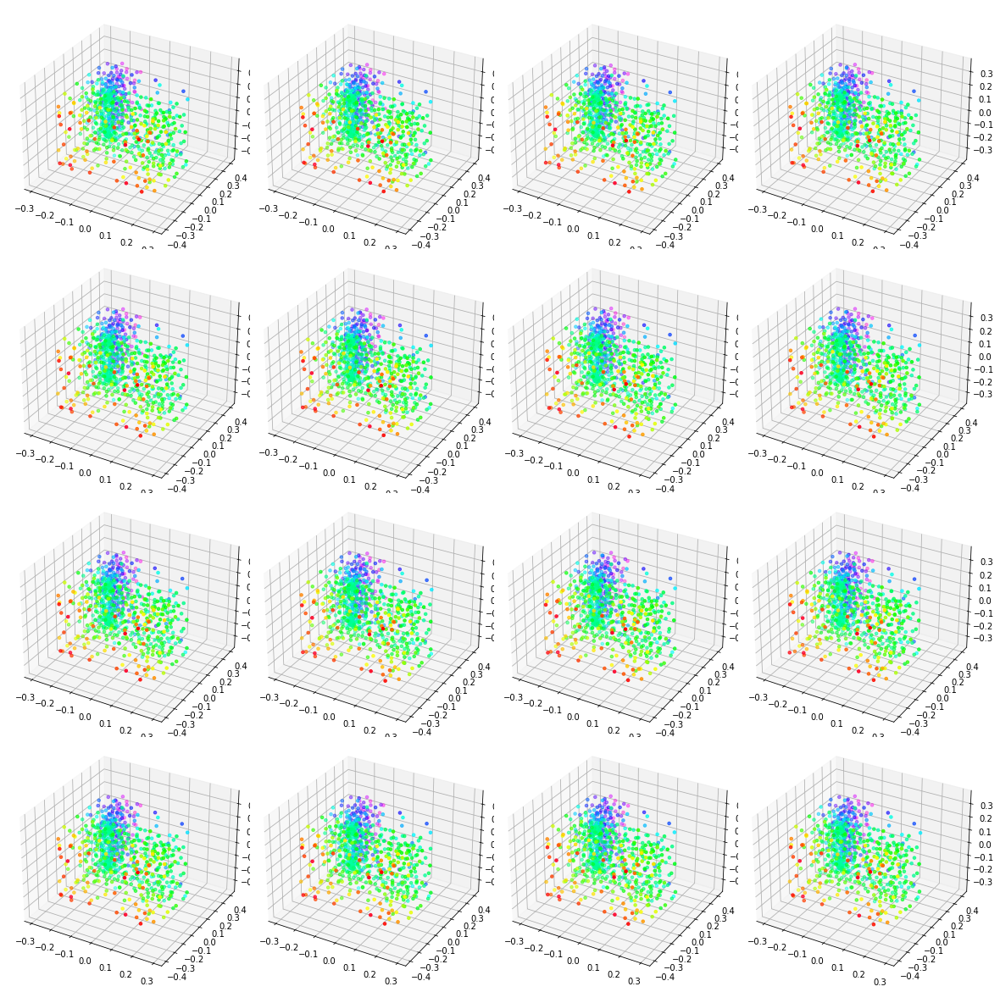

16
0 17/400 2070/121 
loss_g= 0.17300, 
loss_e=-0.01114, 
en_pos=[ -0.15152,  -0.16075,  -0.00923], 
en_neg=[ -0.14037,  -0.13114,   0.00923], 
|z_g_0|=45.319, 
|z_g_k|=46.600, 
|z_e_0|=45.138, 
|z_e_k|=46.665, 
z_e_disp=64.908, 
z_g_disp=64.903, 
x_e_disp= 0.332, 
prior_moments=[   -0.00,     1.03,     4.58], 
posterior_moments=[    0.00,     1.03,     4.27], 



 ---------------------
0 17/400 2085/121 
loss_g= 0.17106, 
loss_e=-0.00812, 
en_pos=[ -0.16563,  -0.17462,  -0.00900], 
en_neg=[ -0.15750,  -0.14809,   0.00941], 
|z_g_0|=45.241, 
|z_g_k|=46.750, 
|z_e_0|=45.269, 
|z_e_k|=46.730, 
z_e_disp=65.171, 
z_g_disp=65.101, 
x_e_disp= 0.322, 
prior_moments=[    0.00,     1.03,     4.54], 
posterior_moments=[   -0.00,     1.03,     4.51], 



 ---------------------
0 17/400 2100/121 
loss_g= 0.14247, 
loss_e=-0.01616, 
en_pos=[ -0.15706,  -0.16719,  -0.01013], 
en_neg=[ -0.14091,  -0.13198,   0.00892], 
|z_g_0|=45.261, 
|z_g_k|=46.660, 
|z_e_0|=45.243, 
|z_e_k|=46.589, 
z_e_disp=64.94

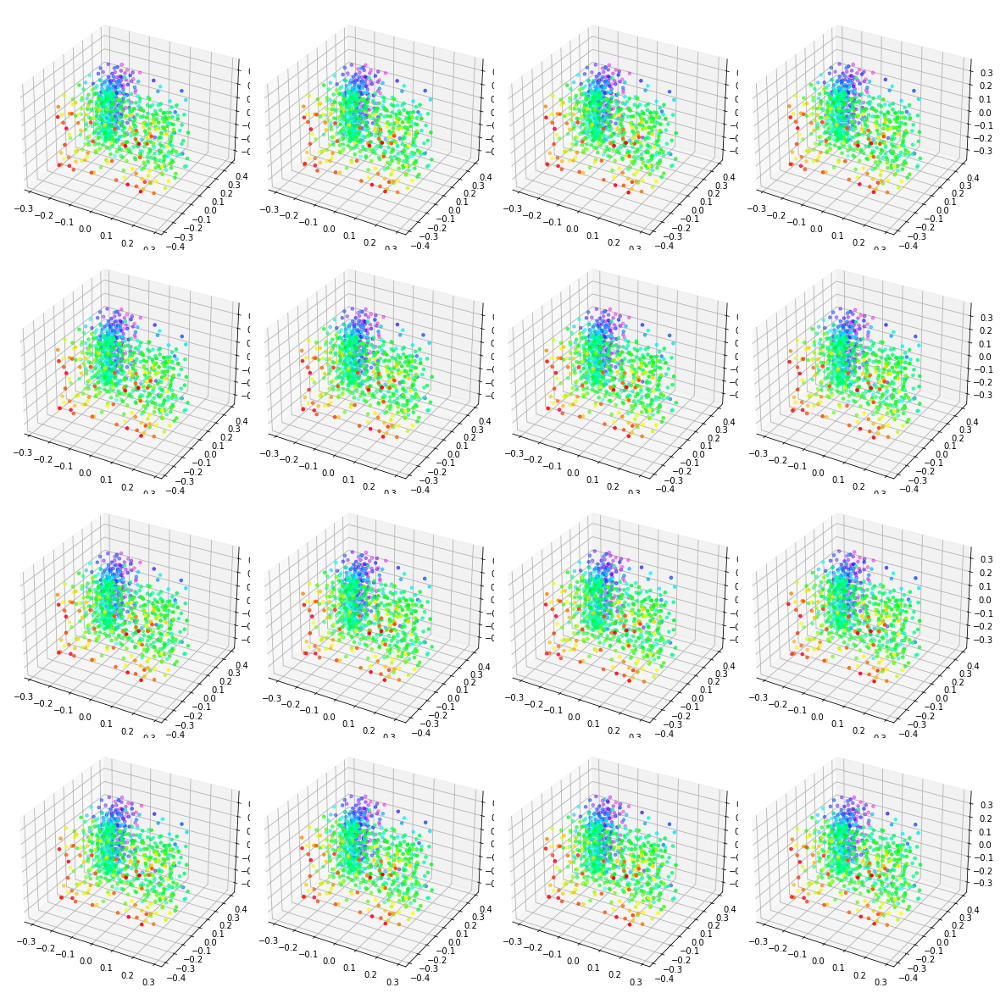

17
0 18/400 2190/121 
loss_g= 0.13541, 
loss_e= 0.00305, 
en_pos=[ -0.13796,  -0.14718,  -0.00922], 
en_neg=[ -0.14101,  -0.13135,   0.00966], 
|z_g_0|=45.174, 
|z_g_k|=46.785, 
|z_e_0|=45.432, 
|z_e_k|=46.628, 
z_e_disp=65.025, 
z_g_disp=65.019, 
x_e_disp= 0.332, 
prior_moments=[   -0.00,     1.03,     4.85], 
posterior_moments=[    0.00,     1.03,     4.60], 



 ---------------------
0 18/400 2205/121 
loss_g= 0.14986, 
loss_e=-0.00902, 
en_pos=[ -0.14905,  -0.15841,  -0.00936], 
en_neg=[ -0.14003,  -0.13031,   0.00971], 
|z_g_0|=45.254, 
|z_g_k|=46.712, 
|z_e_0|=45.203, 
|z_e_k|=46.727, 
z_e_disp=64.975, 
z_g_disp=64.782, 
x_e_disp= 0.332, 
prior_moments=[   -0.00,     1.03,     5.15], 
posterior_moments=[    0.01,     1.03,     4.51], 



 ---------------------
0 18/400 2220/121 
loss_g= 0.18651, 
loss_e= 0.00434, 
en_pos=[ -0.13599,  -0.14554,  -0.00955], 
en_neg=[ -0.14033,  -0.13148,   0.00885], 
|z_g_0|=45.301, 
|z_g_k|=46.754, 
|z_e_0|=45.332, 
|z_e_k|=46.805, 
z_e_disp=65.19

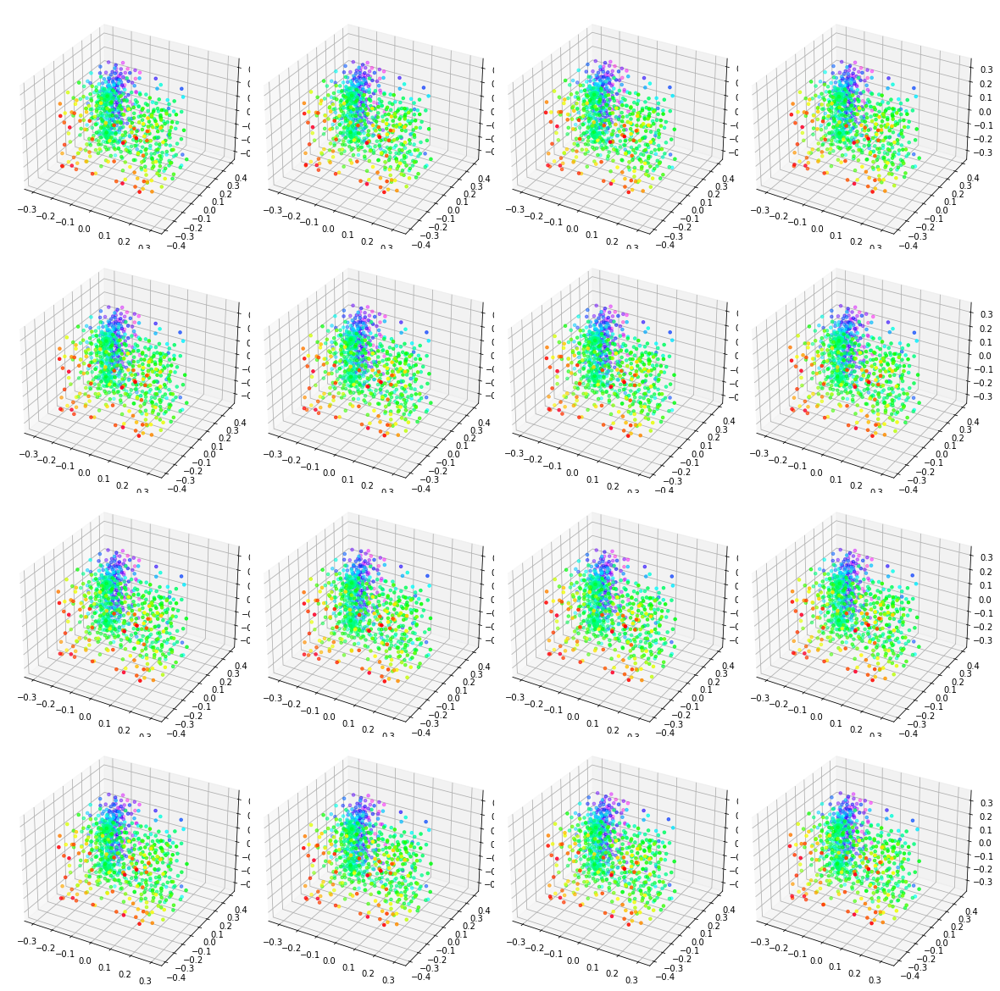

18
0 19/400 2310/121 
loss_g= 0.13966, 
loss_e= 0.01627, 
en_pos=[ -0.13544,  -0.14444,  -0.00900], 
en_neg=[ -0.15171,  -0.14206,   0.00965], 
|z_g_0|=45.149, 
|z_g_k|=46.748, 
|z_e_0|=45.268, 
|z_e_k|=46.890, 
z_e_disp=65.353, 
z_g_disp=65.036, 
x_e_disp= 0.352, 
prior_moments=[    0.00,     1.04,     4.36], 
posterior_moments=[   -0.00,     1.03,     5.18], 



 ---------------------
0 19/400 2325/121 
loss_g= 0.18173, 
loss_e= 0.00843, 
en_pos=[ -0.14962,  -0.15969,  -0.01007], 
en_neg=[ -0.15804,  -0.14933,   0.00871], 
|z_g_0|=45.225, 
|z_g_k|=46.689, 
|z_e_0|=45.127, 
|z_e_k|=46.668, 
z_e_disp=64.806, 
z_g_disp=64.768, 
x_e_disp= 0.316, 
prior_moments=[    0.00,     1.03,     4.33], 
posterior_moments=[    0.00,     1.03,     4.70], 



 ---------------------
0 19/400 2340/121 
loss_g= 0.17093, 
loss_e= 0.00632, 
en_pos=[ -0.14958,  -0.15843,  -0.00885], 
en_neg=[ -0.15590,  -0.14733,   0.00857], 
|z_g_0|=45.146, 
|z_g_k|=46.746, 
|z_e_0|=45.088, 
|z_e_k|=46.683, 
z_e_disp=64.79

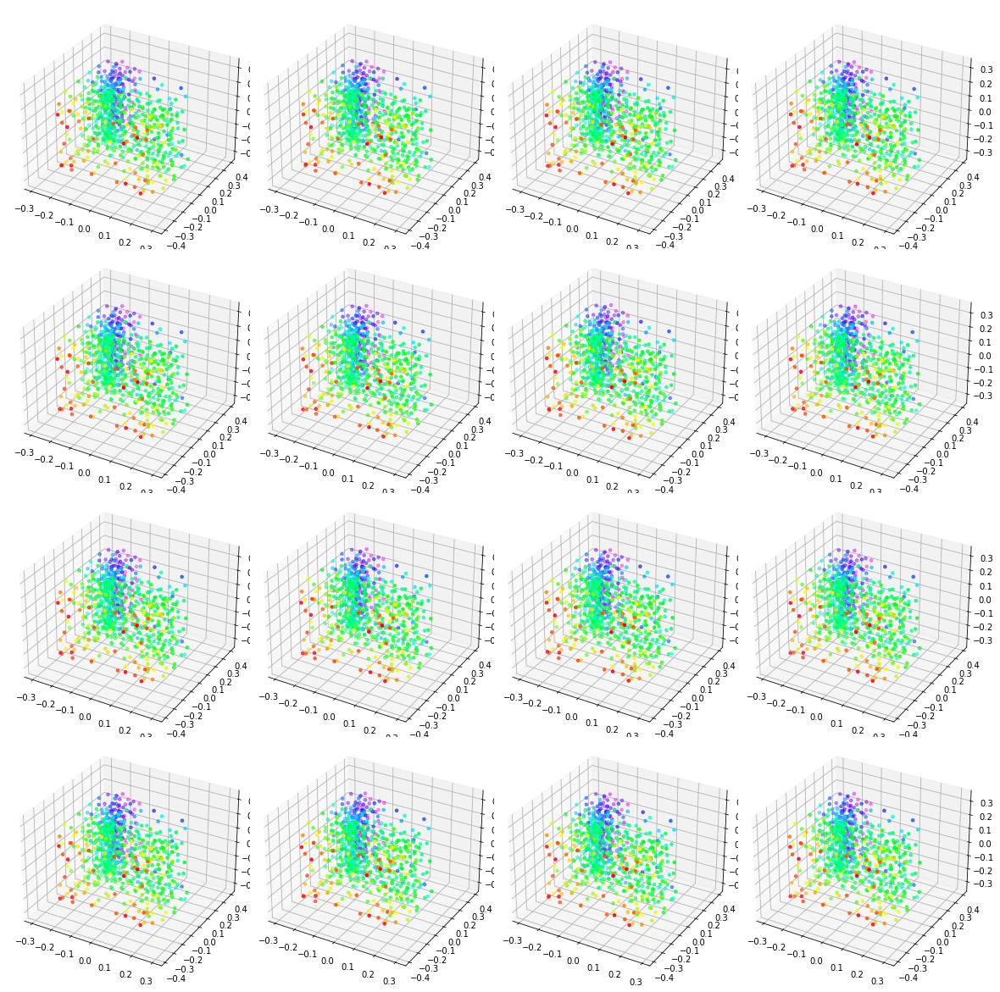

19
0 20/400 2430/121 
loss_g= 0.16105, 
loss_e= 0.01906, 
en_pos=[ -0.14771,  -0.15683,  -0.00912], 
en_neg=[ -0.16677,  -0.15765,   0.00912], 
|z_g_0|=45.168, 
|z_g_k|=46.729, 
|z_e_0|=45.245, 
|z_e_k|=46.740, 
z_e_disp=65.106, 
z_g_disp=64.626, 
x_e_disp= 0.340, 
prior_moments=[    0.00,     1.03,     4.57], 
posterior_moments=[   -0.00,     1.03,     4.23], 



 ---------------------
0 20/400 2445/121 
loss_g= 0.13856, 
loss_e=-0.01392, 
en_pos=[ -0.16022,  -0.16971,  -0.00949], 
en_neg=[ -0.14629,  -0.13722,   0.00907], 
|z_g_0|=45.346, 
|z_g_k|=46.886, 
|z_e_0|=45.284, 
|z_e_k|=46.644, 
z_e_disp=65.003, 
z_g_disp=65.073, 
x_e_disp= 0.326, 
prior_moments=[    0.01,     1.03,     4.74], 
posterior_moments=[    0.01,     1.04,     4.69], 



 ---------------------
0 20/400 2460/121 
loss_g= 0.14158, 
loss_e=-0.00790, 
en_pos=[ -0.16170,  -0.17144,  -0.00974], 
en_neg=[ -0.15379,  -0.14463,   0.00916], 
|z_g_0|=45.132, 
|z_g_k|=46.780, 
|z_e_0|=45.245, 
|z_e_k|=46.695, 
z_e_disp=65.03

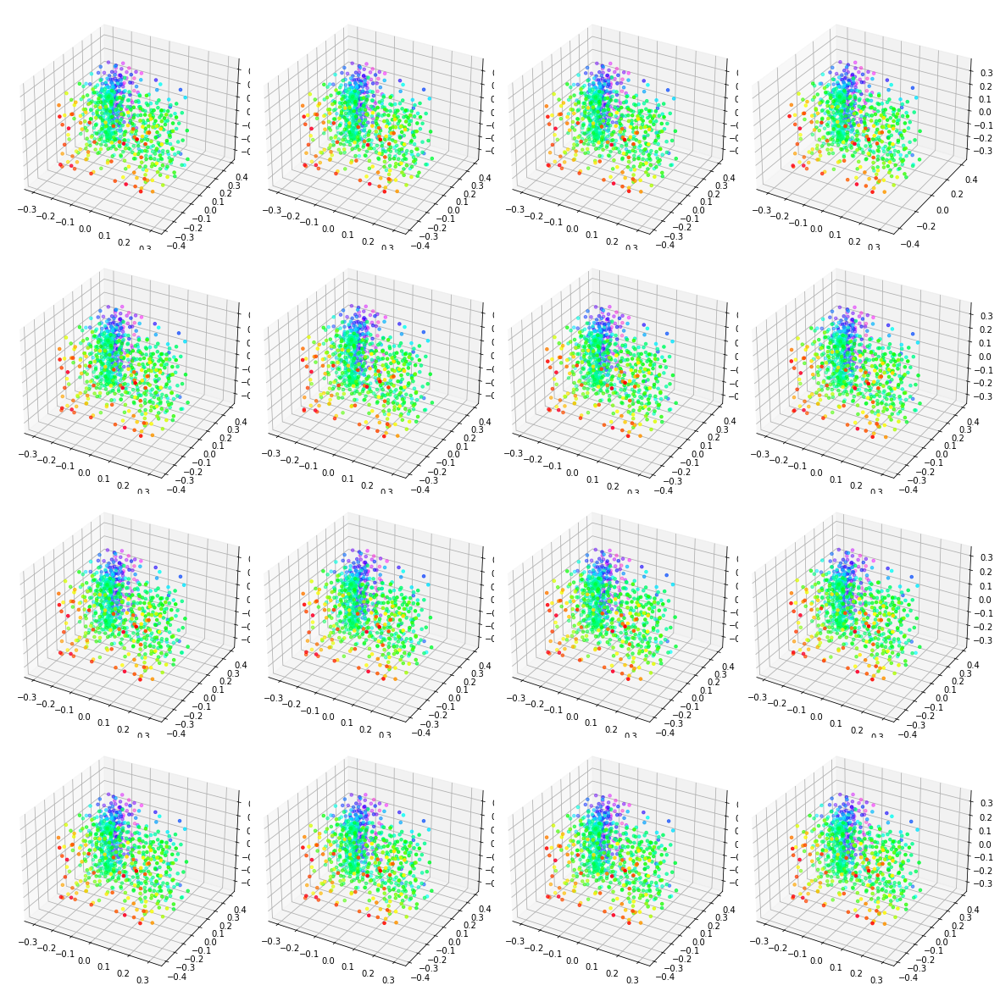

20
0 21/400 2550/121 
loss_g= 0.14331, 
loss_e=-0.00192, 
en_pos=[ -0.15633,  -0.16568,  -0.00935], 
en_neg=[ -0.15441,  -0.14494,   0.00947], 
|z_g_0|=45.234, 
|z_g_k|=46.804, 
|z_e_0|=45.288, 
|z_e_k|=46.892, 
z_e_disp=65.268, 
z_g_disp=64.909, 
x_e_disp= 0.310, 
prior_moments=[    0.01,     1.04,     5.47], 
posterior_moments=[   -0.01,     1.03,     4.43], 



 ---------------------
0 21/400 2565/121 
loss_g= 0.16542, 
loss_e=-0.02913, 
en_pos=[ -0.16084,  -0.16929,  -0.00845], 
en_neg=[ -0.13172,  -0.12223,   0.00949], 
|z_g_0|=45.362, 
|z_g_k|=46.642, 
|z_e_0|=45.281, 
|z_e_k|=46.669, 
z_e_disp=65.090, 
z_g_disp=64.838, 
x_e_disp= 0.302, 
prior_moments=[    0.00,     1.03,     4.33], 
posterior_moments=[   -0.00,     1.03,     4.68], 



 ---------------------
0 21/400 2580/121 
loss_g= 0.15648, 
loss_e= 0.03424, 
en_pos=[ -0.11907,  -0.12781,  -0.00873], 
en_neg=[ -0.15332,  -0.14391,   0.00941], 
|z_g_0|=45.397, 
|z_g_k|=46.735, 
|z_e_0|=45.291, 
|z_e_k|=46.586, 
z_e_disp=64.96

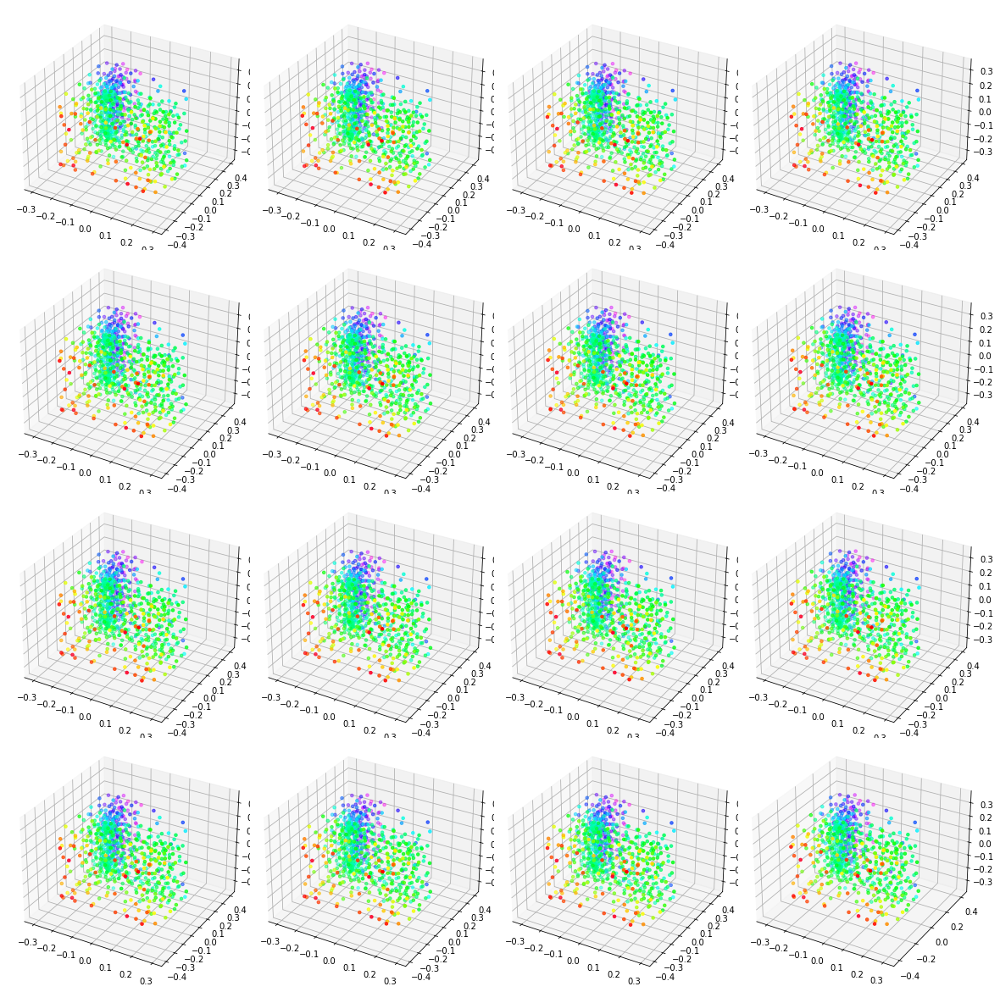

21
0 22/400 2670/121 
loss_g= 0.14417, 
loss_e=-0.03732, 
en_pos=[ -0.16994,  -0.17920,  -0.00926], 
en_neg=[ -0.13262,  -0.12373,   0.00889], 
|z_g_0|=45.187, 
|z_g_k|=46.672, 
|z_e_0|=45.339, 
|z_e_k|=46.771, 
z_e_disp=64.981, 
z_g_disp=64.783, 
x_e_disp= 0.312, 
prior_moments=[   -0.00,     1.03,     5.12], 
posterior_moments=[   -0.00,     1.03,     4.67], 



 ---------------------
0 22/400 2685/121 
loss_g= 0.18366, 
loss_e=-0.01347, 
en_pos=[ -0.16788,  -0.17698,  -0.00910], 
en_neg=[ -0.15441,  -0.14522,   0.00920], 
|z_g_0|=45.379, 
|z_g_k|=46.573, 
|z_e_0|=45.255, 
|z_e_k|=46.621, 
z_e_disp=64.913, 
z_g_disp=64.918, 
x_e_disp= 0.314, 
prior_moments=[    0.00,     1.03,     4.91], 
posterior_moments=[    0.00,     1.03,     4.83], 



 ---------------------
0 22/400 2700/121 
loss_g= 0.14874, 
loss_e= 0.00658, 
en_pos=[ -0.11772,  -0.12720,  -0.00949], 
en_neg=[ -0.12429,  -0.11538,   0.00891], 
|z_g_0|=45.308, 
|z_g_k|=46.762, 
|z_e_0|=45.147, 
|z_e_k|=46.658, 
z_e_disp=64.92

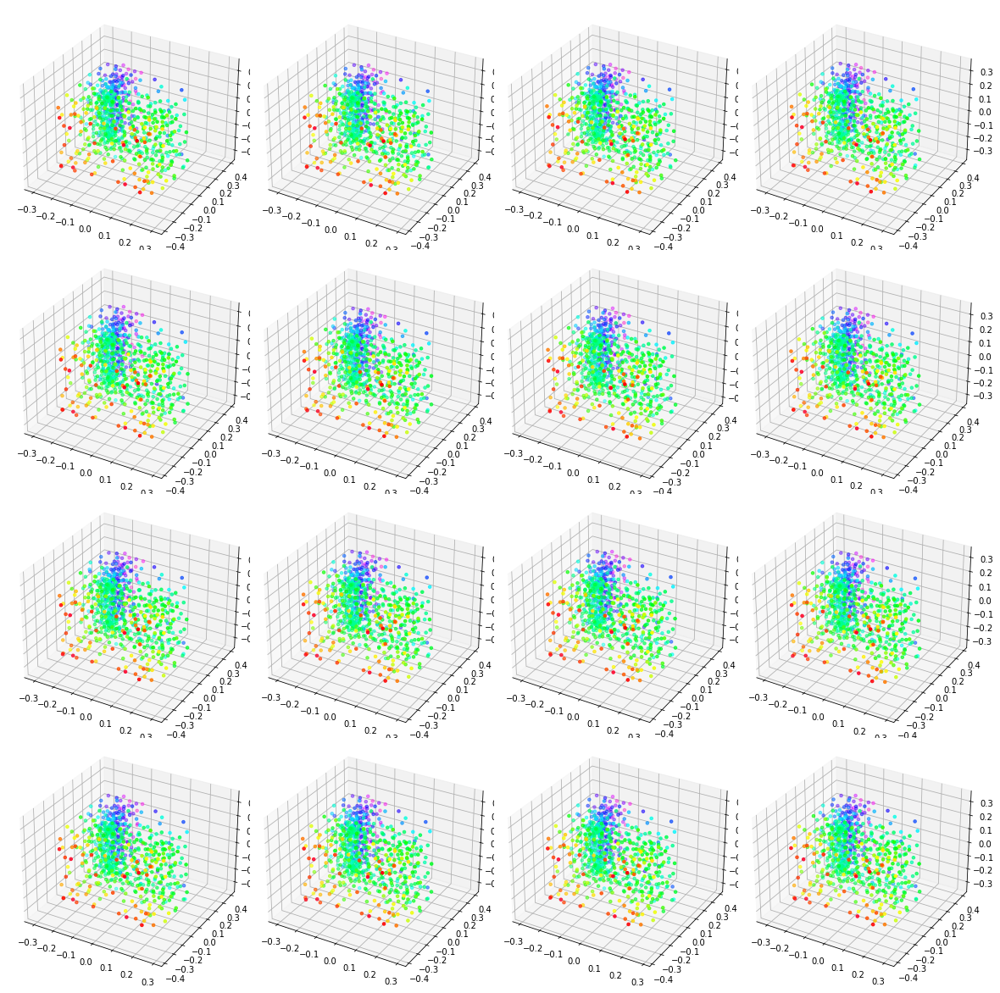

22
0 23/400 2790/121 
loss_g= 0.14271, 
loss_e= 0.01630, 
en_pos=[ -0.13157,  -0.14083,  -0.00926], 
en_neg=[ -0.14787,  -0.13830,   0.00957], 
|z_g_0|=45.063, 
|z_g_k|=46.707, 
|z_e_0|=45.348, 
|z_e_k|=46.780, 
z_e_disp=65.220, 
z_g_disp=64.855, 
x_e_disp= 0.309, 
prior_moments=[   -0.00,     1.03,     4.82], 
posterior_moments=[    0.00,     1.03,     4.38], 



 ---------------------
0 23/400 2805/121 
loss_g= 0.14999, 
loss_e=-0.00369, 
en_pos=[ -0.12886,  -0.13804,  -0.00918], 
en_neg=[ -0.12517,  -0.11573,   0.00943], 
|z_g_0|=45.293, 
|z_g_k|=46.790, 
|z_e_0|=45.371, 
|z_e_k|=46.695, 
z_e_disp=65.140, 
z_g_disp=65.065, 
x_e_disp= 0.316, 
prior_moments=[   -0.00,     1.03,     4.86], 
posterior_moments=[   -0.00,     1.03,     4.72], 



 ---------------------
0 23/400 2820/121 
loss_g= 0.14756, 
loss_e= 0.00774, 
en_pos=[ -0.14659,  -0.15556,  -0.00897], 
en_neg=[ -0.15433,  -0.14457,   0.00976], 
|z_g_0|=45.245, 
|z_g_k|=46.774, 
|z_e_0|=45.182, 
|z_e_k|=47.067, 
z_e_disp=65.38

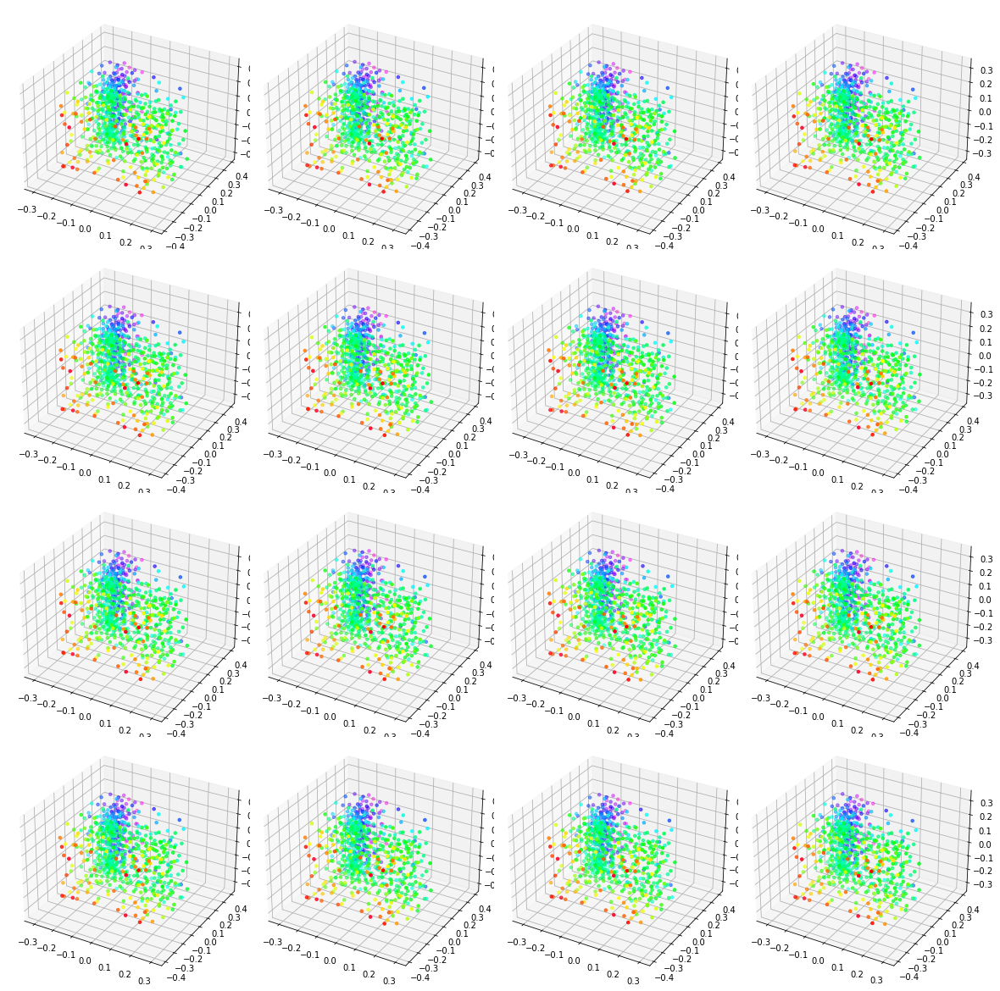

23
0 24/400 2910/121 
loss_g= 0.15193, 
loss_e=-0.00019, 
en_pos=[ -0.14219,  -0.15152,  -0.00932], 
en_neg=[ -0.14200,  -0.13229,   0.00971], 
|z_g_0|=45.406, 
|z_g_k|=46.683, 
|z_e_0|=45.291, 
|z_e_k|=46.847, 
z_e_disp=65.270, 
z_g_disp=64.961, 
x_e_disp= 0.310, 
prior_moments=[    0.00,     1.04,     4.47], 
posterior_moments=[    0.00,     1.03,     4.53], 



 ---------------------
0 24/400 2925/121 
loss_g= 0.16762, 
loss_e=-0.01498, 
en_pos=[ -0.13870,  -0.14840,  -0.00971], 
en_neg=[ -0.12372,  -0.11397,   0.00975], 
|z_g_0|=45.263, 
|z_g_k|=46.503, 
|z_e_0|=45.015, 
|z_e_k|=46.795, 
z_e_disp=64.971, 
z_g_disp=64.866, 
x_e_disp= 0.301, 
prior_moments=[    0.00,     1.03,     4.34], 
posterior_moments=[    0.00,     1.03,     5.15], 



 ---------------------
0 24/400 2940/121 
loss_g= 0.14963, 
loss_e= 0.00481, 
en_pos=[ -0.12085,  -0.13010,  -0.00925], 
en_neg=[ -0.12566,  -0.11596,   0.00970], 
|z_g_0|=45.123, 
|z_g_k|=46.630, 
|z_e_0|=45.143, 
|z_e_k|=46.805, 
z_e_disp=64.92

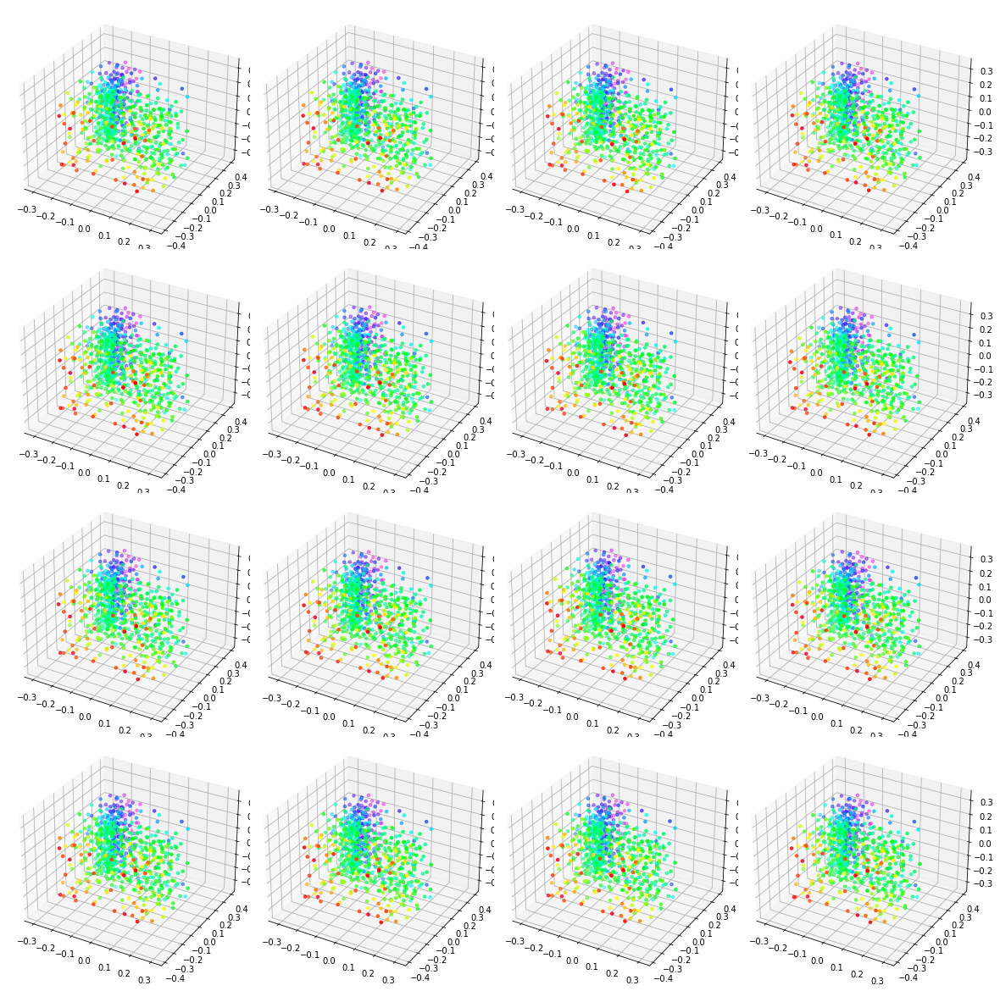

24
0 25/400 3030/121 
loss_g= 0.16737, 
loss_e=-0.02163, 
en_pos=[ -0.15588,  -0.16520,  -0.00932], 
en_neg=[ -0.13425,  -0.12504,   0.00921], 
|z_g_0|=45.495, 
|z_g_k|=46.672, 
|z_e_0|=45.106, 
|z_e_k|=46.698, 
z_e_disp=65.011, 
z_g_disp=65.148, 
x_e_disp= 0.317, 
prior_moments=[   -0.00,     1.03,     4.89], 
posterior_moments=[    0.00,     1.03,     4.50], 



 ---------------------
0 25/400 3045/121 
loss_g= 0.13208, 
loss_e=-0.01999, 
en_pos=[ -0.16801,  -0.17771,  -0.00970], 
en_neg=[ -0.14802,  -0.13886,   0.00916], 
|z_g_0|=45.208, 
|z_g_k|=46.776, 
|z_e_0|=45.366, 
|z_e_k|=46.842, 
z_e_disp=65.143, 
z_g_disp=65.021, 
x_e_disp= 0.328, 
prior_moments=[    0.00,     1.04,     4.51], 
posterior_moments=[    0.00,     1.03,     4.38], 



 ---------------------
0 25/400 3060/121 
loss_g= 0.16822, 
loss_e=-0.00250, 
en_pos=[ -0.15005,  -0.15958,  -0.00952], 
en_neg=[ -0.14756,  -0.13816,   0.00940], 
|z_g_0|=45.159, 
|z_g_k|=46.786, 
|z_e_0|=45.274, 
|z_e_k|=46.585, 
z_e_disp=64.92

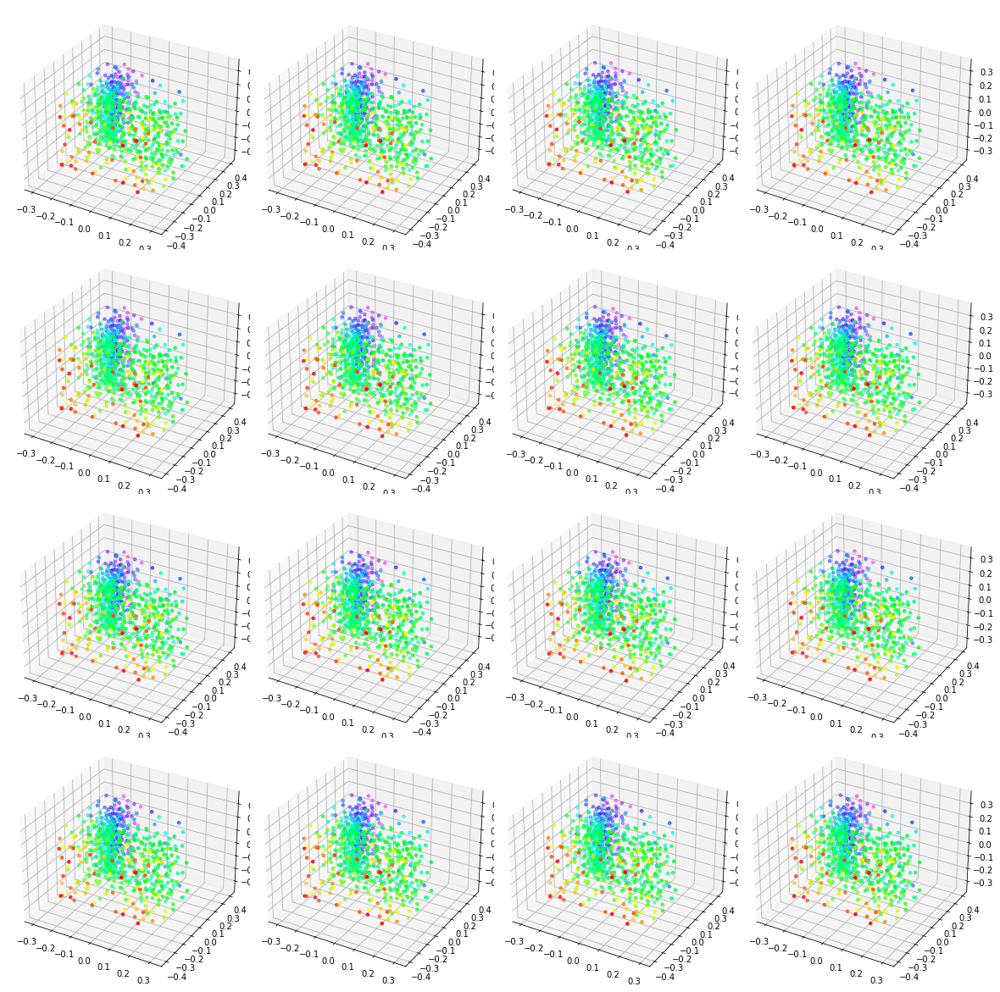

25
0 26/400 3150/121 
loss_g= 0.17180, 
loss_e= 0.00719, 
en_pos=[ -0.14128,  -0.15088,  -0.00960], 
en_neg=[ -0.14847,  -0.13898,   0.00949], 
|z_g_0|=45.220, 
|z_g_k|=46.719, 
|z_e_0|=45.146, 
|z_e_k|=46.737, 
z_e_disp=64.953, 
z_g_disp=65.061, 
x_e_disp= 0.300, 
prior_moments=[   -0.00,     1.03,     4.48], 
posterior_moments=[   -0.00,     1.03,     4.91], 



 ---------------------
0 26/400 3165/121 
loss_g= 0.17015, 
loss_e= 0.00300, 
en_pos=[ -0.14573,  -0.15503,  -0.00930], 
en_neg=[ -0.14874,  -0.13951,   0.00923], 
|z_g_0|=44.946, 
|z_g_k|=46.698, 
|z_e_0|=45.220, 
|z_e_k|=46.722, 
z_e_disp=65.141, 
z_g_disp=64.683, 
x_e_disp= 0.309, 
prior_moments=[   -0.00,     1.03,     4.61], 
posterior_moments=[    0.00,     1.03,     5.03], 



 ---------------------
0 26/400 3180/121 
loss_g= 0.19725, 
loss_e=-0.02500, 
en_pos=[ -0.17646,  -0.18616,  -0.00970], 
en_neg=[ -0.15146,  -0.14202,   0.00944], 
|z_g_0|=45.242, 
|z_g_k|=46.720, 
|z_e_0|=45.282, 
|z_e_k|=46.690, 
z_e_disp=65.15

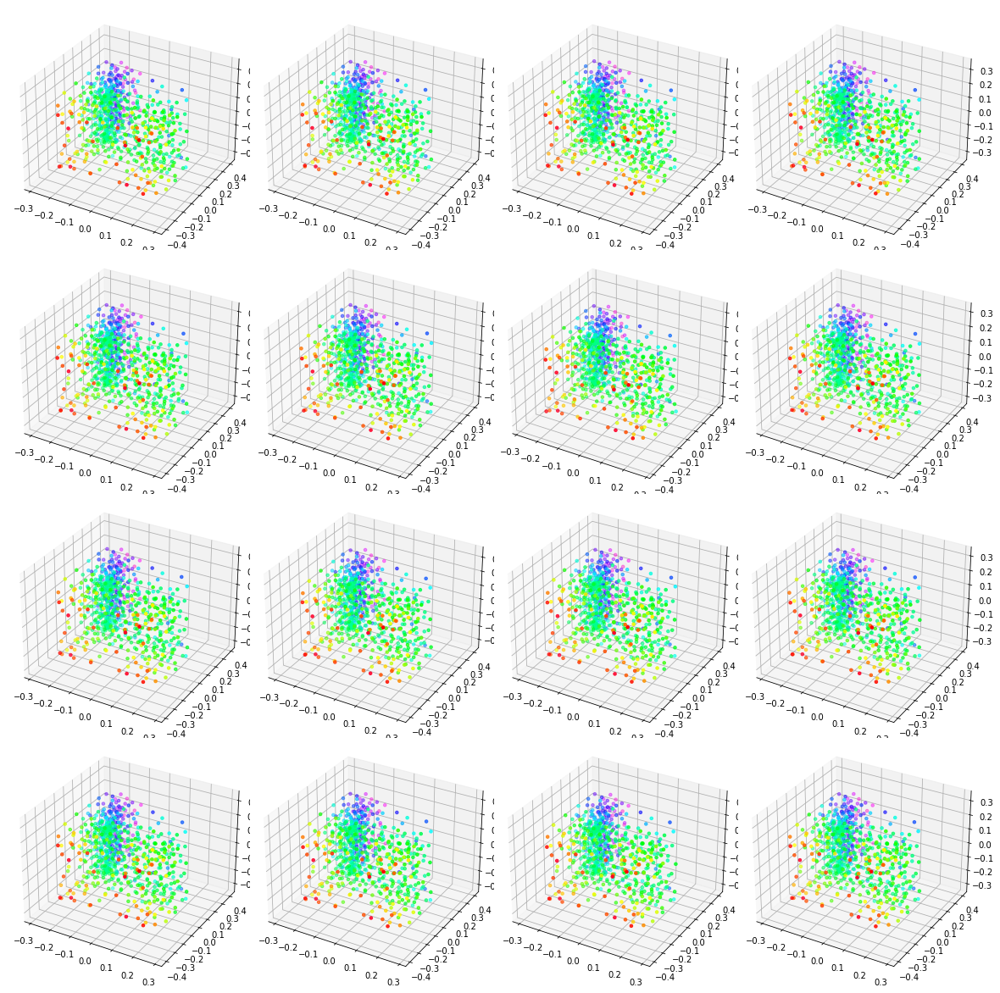

26
0 27/400 3270/121 
loss_g= 0.18530, 
loss_e=-0.00937, 
en_pos=[ -0.14445,  -0.15390,  -0.00945], 
en_neg=[ -0.13508,  -0.12568,   0.00941], 
|z_g_0|=45.245, 
|z_g_k|=46.617, 
|z_e_0|=45.228, 
|z_e_k|=46.656, 
z_e_disp=65.097, 
z_g_disp=64.787, 
x_e_disp= 0.281, 
prior_moments=[    0.00,     1.03,     4.57], 
posterior_moments=[    0.00,     1.03,     4.64], 



 ---------------------
0 27/400 3285/121 
loss_g= 0.15736, 
loss_e= 0.03221, 
en_pos=[ -0.12153,  -0.13053,  -0.00900], 
en_neg=[ -0.15374,  -0.14454,   0.00920], 
|z_g_0|=45.255, 
|z_g_k|=46.563, 
|z_e_0|=45.298, 
|z_e_k|=46.603, 
z_e_disp=65.186, 
z_g_disp=64.710, 
x_e_disp= 0.274, 
prior_moments=[   -0.00,     1.03,     4.45], 
posterior_moments=[    0.00,     1.03,     4.58], 



 ---------------------
0 27/400 3300/121 
loss_g= 0.17246, 
loss_e=-0.00731, 
en_pos=[ -0.16635,  -0.17589,  -0.00953], 
en_neg=[ -0.15904,  -0.14932,   0.00972], 
|z_g_0|=45.210, 
|z_g_k|=46.669, 
|z_e_0|=45.260, 
|z_e_k|=46.816, 
z_e_disp=65.01

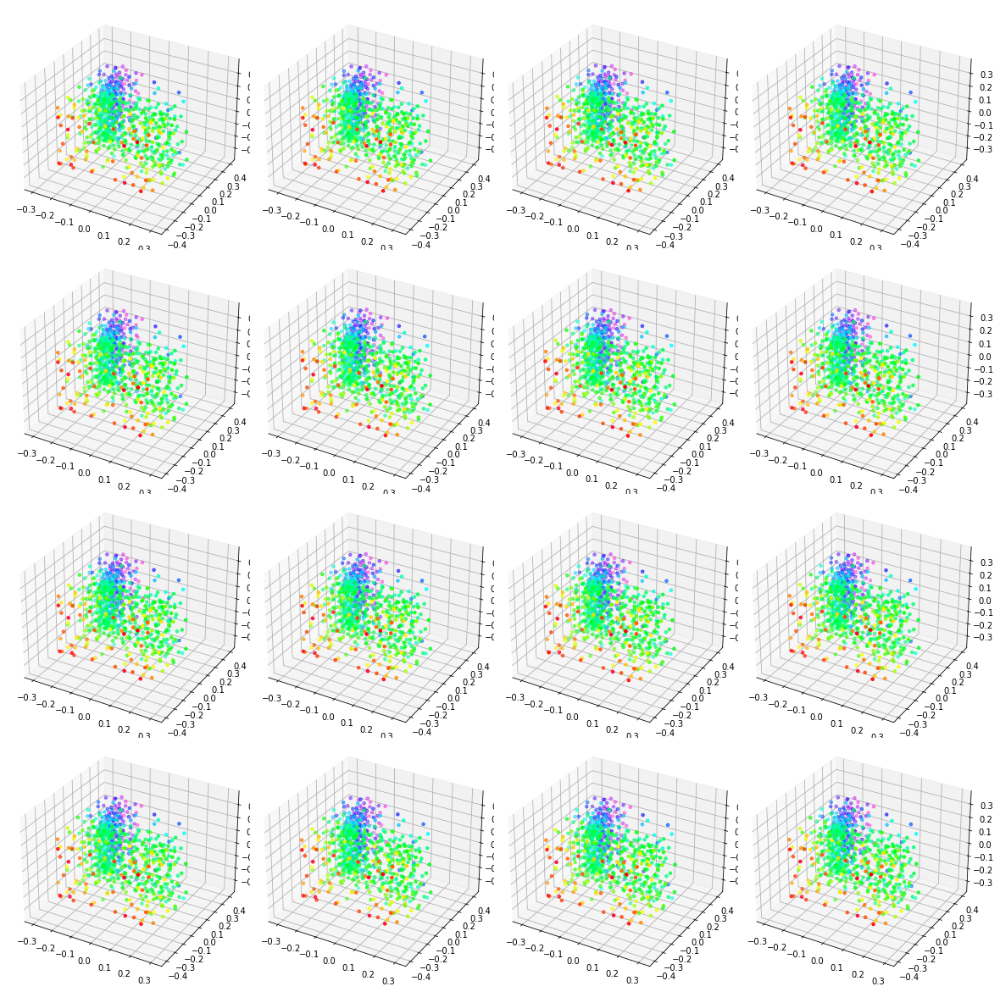

27
0 28/400 3390/121 
loss_g= 0.16132, 
loss_e= 0.02004, 
en_pos=[ -0.12582,  -0.13482,  -0.00901], 
en_neg=[ -0.14586,  -0.13619,   0.00967], 
|z_g_0|=45.125, 
|z_g_k|=46.658, 
|z_e_0|=45.474, 
|z_e_k|=46.875, 
z_e_disp=65.291, 
z_g_disp=64.751, 
x_e_disp= 0.299, 
prior_moments=[   -0.01,     1.04,     5.15], 
posterior_moments=[    0.00,     1.03,     4.65], 



 ---------------------
0 28/400 3405/121 
loss_g= 0.15439, 
loss_e= 0.00343, 
en_pos=[ -0.14937,  -0.15897,  -0.00960], 
en_neg=[ -0.15280,  -0.14303,   0.00977], 
|z_g_0|=45.262, 
|z_g_k|=46.649, 
|z_e_0|=45.330, 
|z_e_k|=46.785, 
z_e_disp=65.257, 
z_g_disp=65.008, 
x_e_disp= 0.282, 
prior_moments=[    0.01,     1.03,     4.63], 
posterior_moments=[   -0.01,     1.03,     5.02], 



 ---------------------
0 28/400 3420/121 
loss_g= 0.13418, 
loss_e= 0.03285, 
en_pos=[ -0.11336,  -0.12259,  -0.00923], 
en_neg=[ -0.14621,  -0.13604,   0.01017], 
|z_g_0|=45.168, 
|z_g_k|=46.549, 
|z_e_0|=45.186, 
|z_e_k|=46.673, 
z_e_disp=65.08

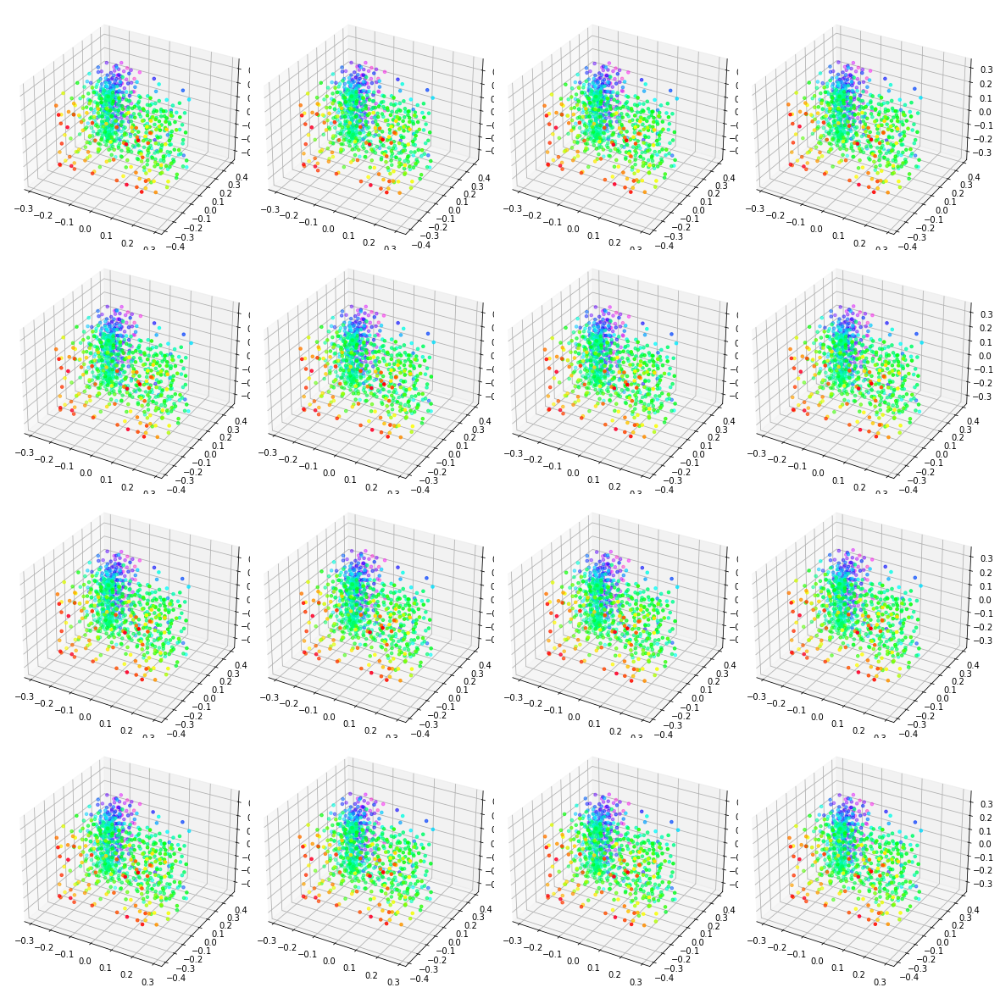

28
0 29/400 3510/121 
loss_g= 0.15417, 
loss_e=-0.02564, 
en_pos=[ -0.14829,  -0.15753,  -0.00924], 
en_neg=[ -0.12265,  -0.11302,   0.00963], 
|z_g_0|=45.219, 
|z_g_k|=46.527, 
|z_e_0|=45.152, 
|z_e_k|=46.755, 
z_e_disp=65.174, 
z_g_disp=64.807, 
x_e_disp= 0.291, 
prior_moments=[    0.01,     1.03,     5.37], 
posterior_moments=[    0.00,     1.03,     4.36], 



 ---------------------
0 29/400 3525/121 
loss_g= 0.16259, 
loss_e= 0.02429, 
en_pos=[ -0.10861,  -0.11782,  -0.00922], 
en_neg=[ -0.13290,  -0.12288,   0.01002], 
|z_g_0|=45.341, 
|z_g_k|=46.563, 
|z_e_0|=45.342, 
|z_e_k|=46.610, 
z_e_disp=65.013, 
z_g_disp=64.911, 
x_e_disp= 0.273, 
prior_moments=[    0.00,     1.03,     4.36], 
posterior_moments=[   -0.00,     1.03,     4.97], 



 ---------------------
0 29/400 3540/121 
loss_g= 0.16406, 
loss_e=-0.03372, 
en_pos=[ -0.17140,  -0.18108,  -0.00968], 
en_neg=[ -0.13768,  -0.12833,   0.00935], 
|z_g_0|=45.136, 
|z_g_k|=46.894, 
|z_e_0|=45.424, 
|z_e_k|=46.731, 
z_e_disp=64.88

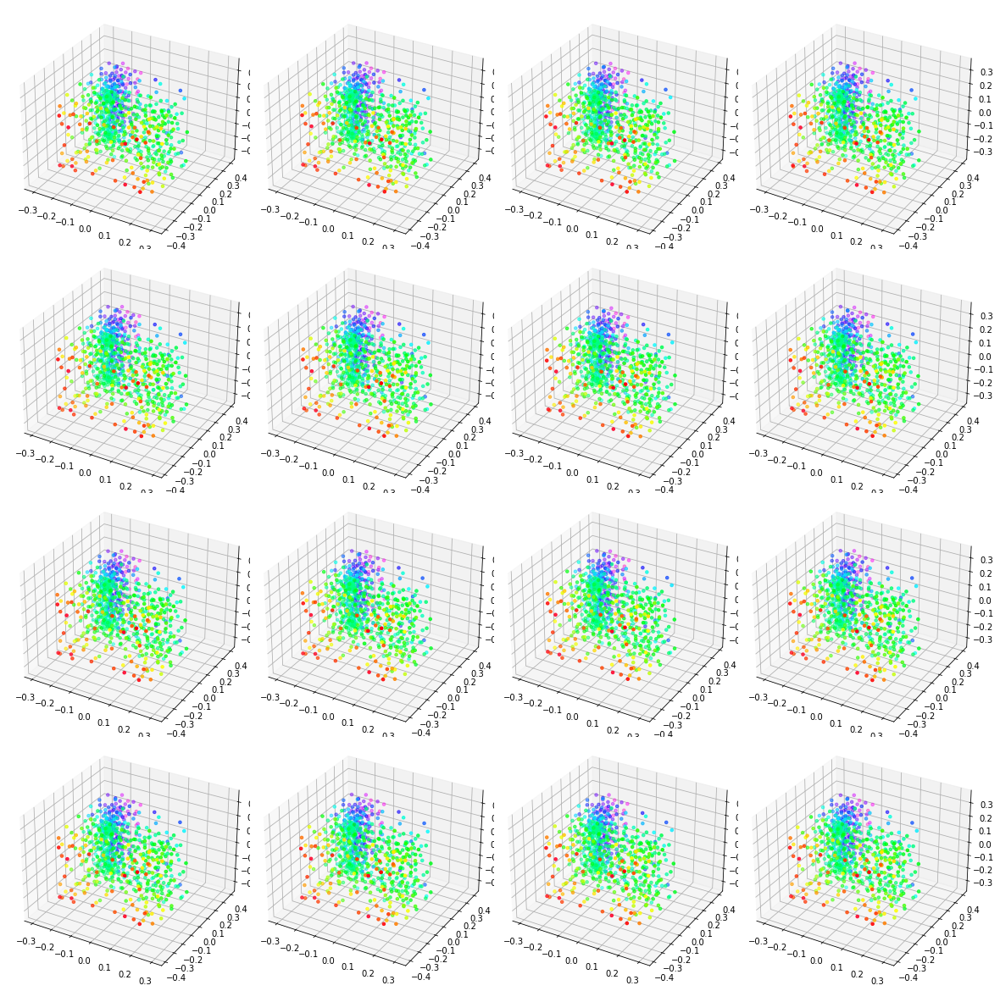

29
0 30/400 3645/121 
loss_g= 0.13870, 
loss_e= 0.01489, 
en_pos=[ -0.12538,  -0.13498,  -0.00960], 
en_neg=[ -0.14026,  -0.13091,   0.00935], 
|z_g_0|=45.201, 
|z_g_k|=46.797, 
|z_e_0|=45.316, 
|z_e_k|=46.669, 
z_e_disp=65.039, 
z_g_disp=65.157, 
x_e_disp= 0.270, 
prior_moments=[   -0.00,     1.03,     4.54], 
posterior_moments=[    0.00,     1.03,     5.28], 



 ---------------------
0 30/400 3660/121 
loss_g= 0.17348, 
loss_e= 0.01365, 
en_pos=[ -0.14053,  -0.14972,  -0.00919], 
en_neg=[ -0.15418,  -0.14423,   0.00995], 
|z_g_0|=45.185, 
|z_g_k|=46.750, 
|z_e_0|=44.998, 
|z_e_k|=46.798, 
z_e_disp=65.053, 
z_g_disp=64.878, 
x_e_disp= 0.281, 
prior_moments=[    0.01,     1.03,     4.95], 
posterior_moments=[   -0.00,     1.03,     5.07], 



 ---------------------
0 30/400 3675/121 
loss_g= 0.14269, 
loss_e=-0.01083, 
en_pos=[ -0.14265,  -0.15260,  -0.00995], 
en_neg=[ -0.13182,  -0.12193,   0.00989], 
|z_g_0|=45.209, 
|z_g_k|=46.795, 
|z_e_0|=45.234, 
|z_e_k|=46.696, 
z_e_disp=64.89

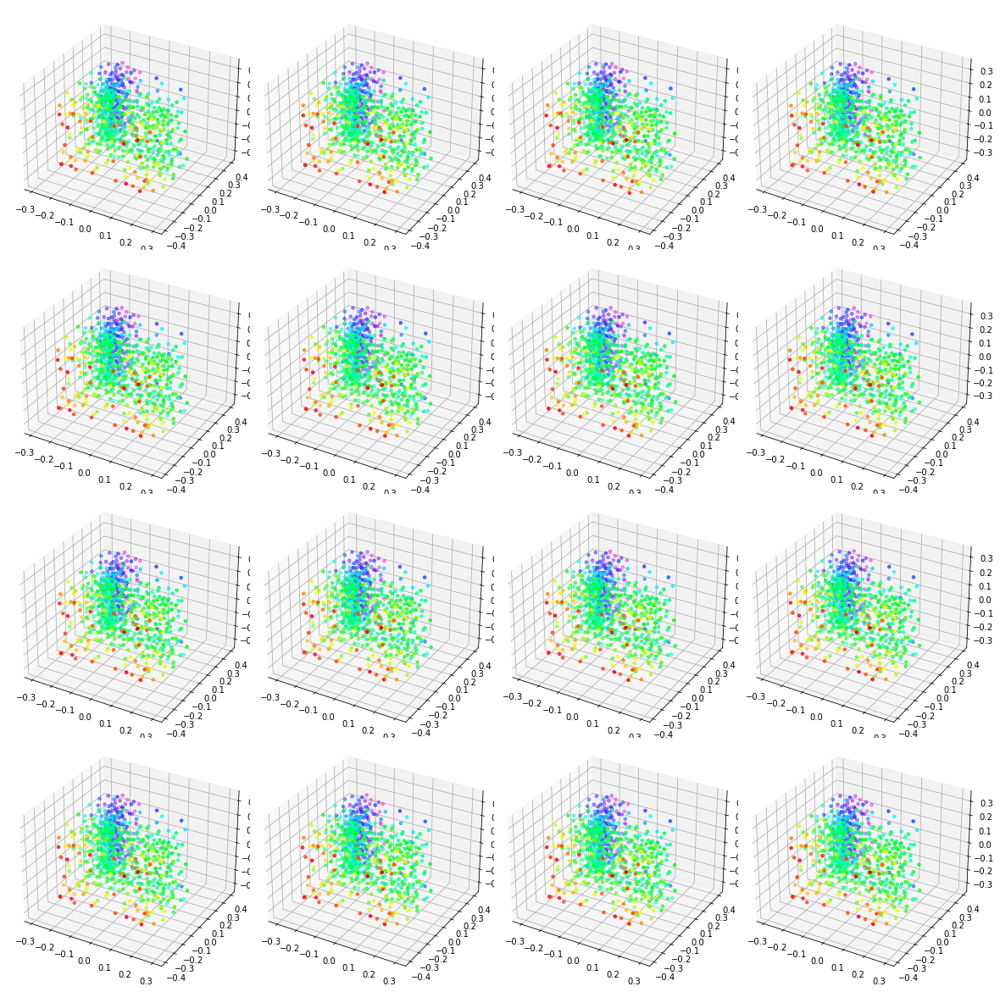

30
0 31/400 3765/121 
loss_g= 0.14292, 
loss_e= 0.01627, 
en_pos=[ -0.12072,  -0.13014,  -0.00942], 
en_neg=[ -0.13699,  -0.12712,   0.00987], 
|z_g_0|=45.220, 
|z_g_k|=46.573, 
|z_e_0|=45.264, 
|z_e_k|=46.722, 
z_e_disp=64.893, 
z_g_disp=64.736, 
x_e_disp= 0.284, 
prior_moments=[   -0.00,     1.03,     4.33], 
posterior_moments=[    0.00,     1.03,     4.56], 



 ---------------------
0 31/400 3780/121 
loss_g= 0.15369, 
loss_e= 0.05281, 
en_pos=[ -0.12895,  -0.13874,  -0.00979], 
en_neg=[ -0.18176,  -0.17236,   0.00940], 
|z_g_0|=45.312, 
|z_g_k|=46.722, 
|z_e_0|=45.278, 
|z_e_k|=46.675, 
z_e_disp=65.076, 
z_g_disp=64.985, 
x_e_disp= 0.266, 
prior_moments=[    0.00,     1.03,     4.73], 
posterior_moments=[    0.00,     1.03,     4.32], 



 ---------------------
0 31/400 3795/121 
loss_g= 0.13756, 
loss_e=-0.00752, 
en_pos=[ -0.12589,  -0.13525,  -0.00935], 
en_neg=[ -0.11837,  -0.10847,   0.00990], 
|z_g_0|=45.206, 
|z_g_k|=46.875, 
|z_e_0|=45.427, 
|z_e_k|=46.796, 
z_e_disp=65.30

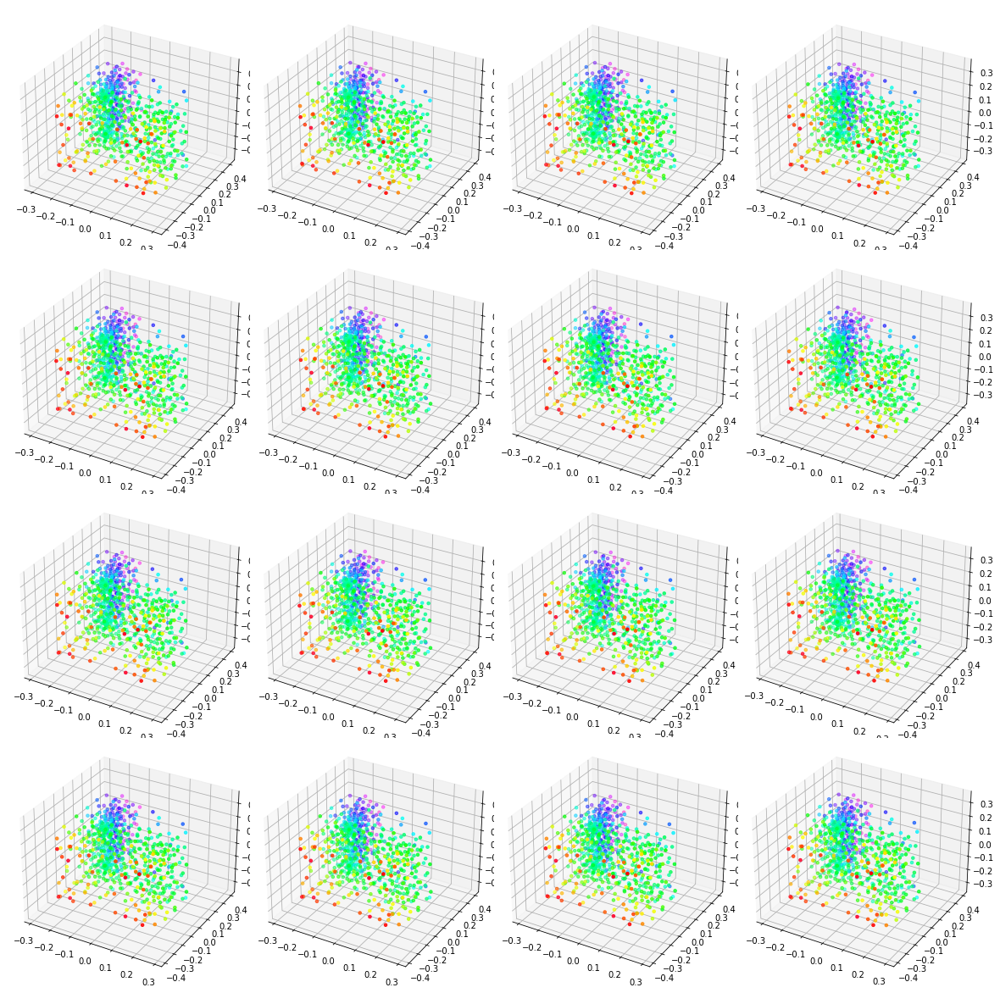

31
0 32/400 3885/121 
loss_g= 0.16182, 
loss_e= 0.01344, 
en_pos=[ -0.13179,  -0.14121,  -0.00942], 
en_neg=[ -0.14523,  -0.13563,   0.00960], 
|z_g_0|=45.163, 
|z_g_k|=46.758, 
|z_e_0|=45.328, 
|z_e_k|=46.614, 
z_e_disp=64.952, 
z_g_disp=64.893, 
x_e_disp= 0.292, 
prior_moments=[   -0.00,     1.03,     4.30], 
posterior_moments=[   -0.00,     1.03,     4.98], 



 ---------------------
0 32/400 3900/121 
loss_g= 0.16215, 
loss_e=-0.01137, 
en_pos=[ -0.14764,  -0.15744,  -0.00981], 
en_neg=[ -0.13626,  -0.12633,   0.00993], 
|z_g_0|=45.270, 
|z_g_k|=46.627, 
|z_e_0|=45.204, 
|z_e_k|=46.681, 
z_e_disp=65.041, 
z_g_disp=64.660, 
x_e_disp= 0.265, 
prior_moments=[    0.00,     1.03,     4.78], 
posterior_moments=[    0.01,     1.03,     4.85], 



 ---------------------
0 32/400 3915/121 
loss_g= 0.15239, 
loss_e= 0.00630, 
en_pos=[ -0.13459,  -0.14394,  -0.00935], 
en_neg=[ -0.14090,  -0.13079,   0.01011], 
|z_g_0|=45.242, 
|z_g_k|=46.619, 
|z_e_0|=45.357, 
|z_e_k|=46.653, 
z_e_disp=64.99

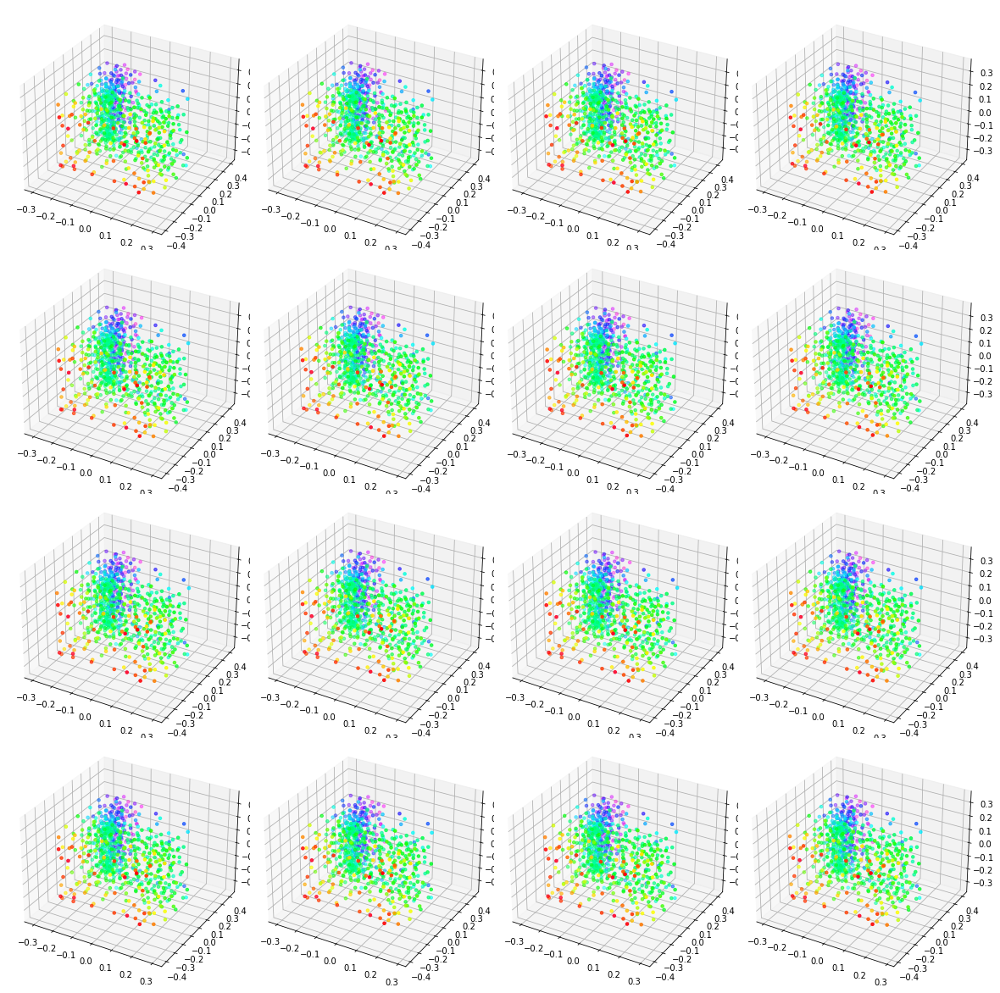

32
0 33/400 4005/121 
loss_g= 0.15822, 
loss_e=-0.03664, 
en_pos=[ -0.17387,  -0.18361,  -0.00974], 
en_neg=[ -0.13723,  -0.12791,   0.00932], 
|z_g_0|=45.312, 
|z_g_k|=46.691, 
|z_e_0|=45.235, 
|z_e_k|=46.515, 
z_e_disp=64.905, 
z_g_disp=64.882, 
x_e_disp= 0.266, 
prior_moments=[    0.00,     1.03,     4.66], 
posterior_moments=[   -0.00,     1.03,     4.74], 



 ---------------------
0 33/400 4020/121 
loss_g= 0.15774, 
loss_e= 0.04140, 
en_pos=[ -0.12389,  -0.13373,  -0.00984], 
en_neg=[ -0.16529,  -0.15551,   0.00978], 
|z_g_0|=45.258, 
|z_g_k|=46.900, 
|z_e_0|=45.126, 
|z_e_k|=46.776, 
z_e_disp=64.784, 
z_g_disp=65.041, 
x_e_disp= 0.252, 
prior_moments=[    0.00,     1.03,     4.19], 
posterior_moments=[   -0.00,     1.04,     4.54], 



 ---------------------
0 33/400 4035/121 
loss_g= 0.16929, 
loss_e= 0.02085, 
en_pos=[ -0.12037,  -0.13055,  -0.01018], 
en_neg=[ -0.14121,  -0.13197,   0.00925], 
|z_g_0|=45.424, 
|z_g_k|=46.866, 
|z_e_0|=45.256, 
|z_e_k|=46.700, 
z_e_disp=65.08

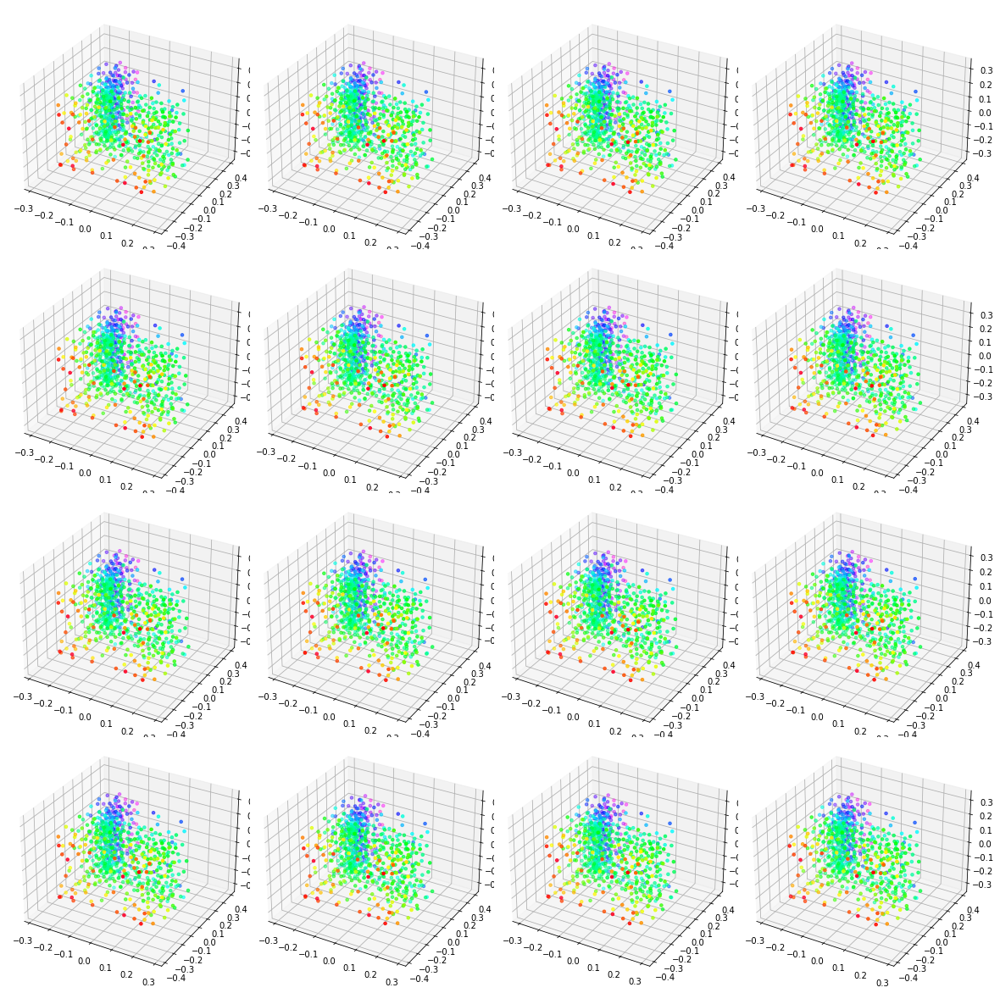

33
0 34/400 4125/121 
loss_g= 0.16577, 
loss_e= 0.00782, 
en_pos=[ -0.15397,  -0.16328,  -0.00931], 
en_neg=[ -0.16179,  -0.15220,   0.00959], 
|z_g_0|=45.080, 
|z_g_k|=46.551, 
|z_e_0|=45.200, 
|z_e_k|=46.693, 
z_e_disp=65.018, 
z_g_disp=64.441, 
x_e_disp= 0.261, 
prior_moments=[    0.01,     1.03,     4.74], 
posterior_moments=[    0.01,     1.03,     4.94], 



 ---------------------
0 34/400 4140/121 
loss_g= 0.12770, 
loss_e=-0.01905, 
en_pos=[ -0.15503,  -0.16450,  -0.00947], 
en_neg=[ -0.13598,  -0.12594,   0.01004], 
|z_g_0|=45.243, 
|z_g_k|=46.784, 
|z_e_0|=45.224, 
|z_e_k|=46.892, 
z_e_disp=65.047, 
z_g_disp=64.807, 
x_e_disp= 0.269, 
prior_moments=[    0.00,     1.04,     4.54], 
posterior_moments=[    0.00,     1.03,     4.84], 



 ---------------------
0 34/400 4155/121 
loss_g= 0.18775, 
loss_e= 0.01289, 
en_pos=[ -0.13478,  -0.14447,  -0.00969], 
en_neg=[ -0.14768,  -0.13822,   0.00945], 
|z_g_0|=45.186, 
|z_g_k|=46.734, 
|z_e_0|=45.259, 
|z_e_k|=46.553, 
z_e_disp=64.89

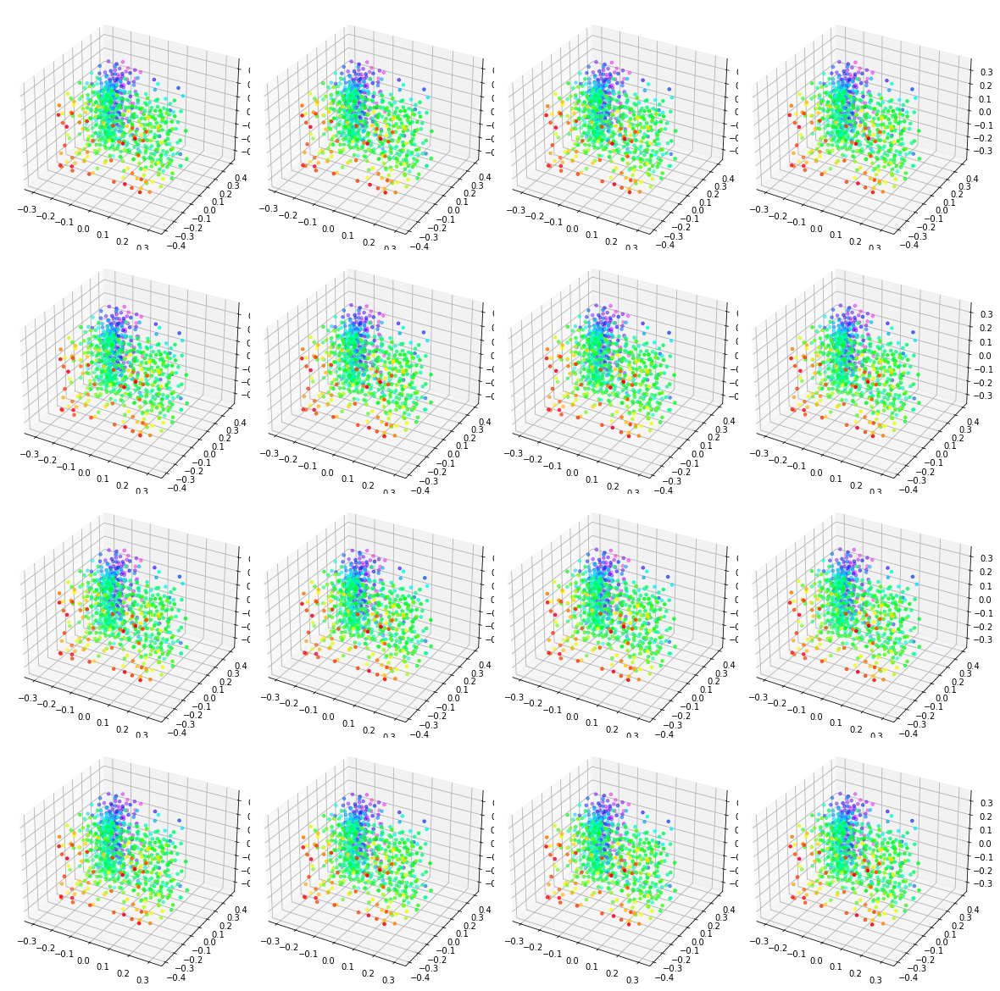

34
0 35/400 4245/121 
loss_g= 0.17906, 
loss_e=-0.00085, 
en_pos=[ -0.15373,  -0.16318,  -0.00945], 
en_neg=[ -0.15288,  -0.14326,   0.00961], 
|z_g_0|=45.154, 
|z_g_k|=46.714, 
|z_e_0|=45.058, 
|z_e_k|=46.679, 
z_e_disp=64.896, 
z_g_disp=64.945, 
x_e_disp= 0.255, 
prior_moments=[   -0.00,     1.03,     4.83], 
posterior_moments=[   -0.00,     1.03,     5.39], 



 ---------------------
0 35/400 4260/121 
loss_g= 0.14473, 
loss_e= 0.00689, 
en_pos=[ -0.12433,  -0.13445,  -0.01011], 
en_neg=[ -0.13122,  -0.12201,   0.00921], 
|z_g_0|=45.161, 
|z_g_k|=46.593, 
|z_e_0|=45.220, 
|z_e_k|=46.884, 
z_e_disp=65.345, 
z_g_disp=64.717, 
x_e_disp= 0.249, 
prior_moments=[   -0.00,     1.04,     4.71], 
posterior_moments=[   -0.01,     1.03,     4.78], 



 ---------------------
0 35/400 4275/121 
loss_g= 0.16577, 
loss_e=-0.01836, 
en_pos=[ -0.16259,  -0.17193,  -0.00934], 
en_neg=[ -0.14423,  -0.13369,   0.01054], 
|z_g_0|=45.294, 
|z_g_k|=46.634, 
|z_e_0|=45.416, 
|z_e_k|=46.685, 
z_e_disp=65.23

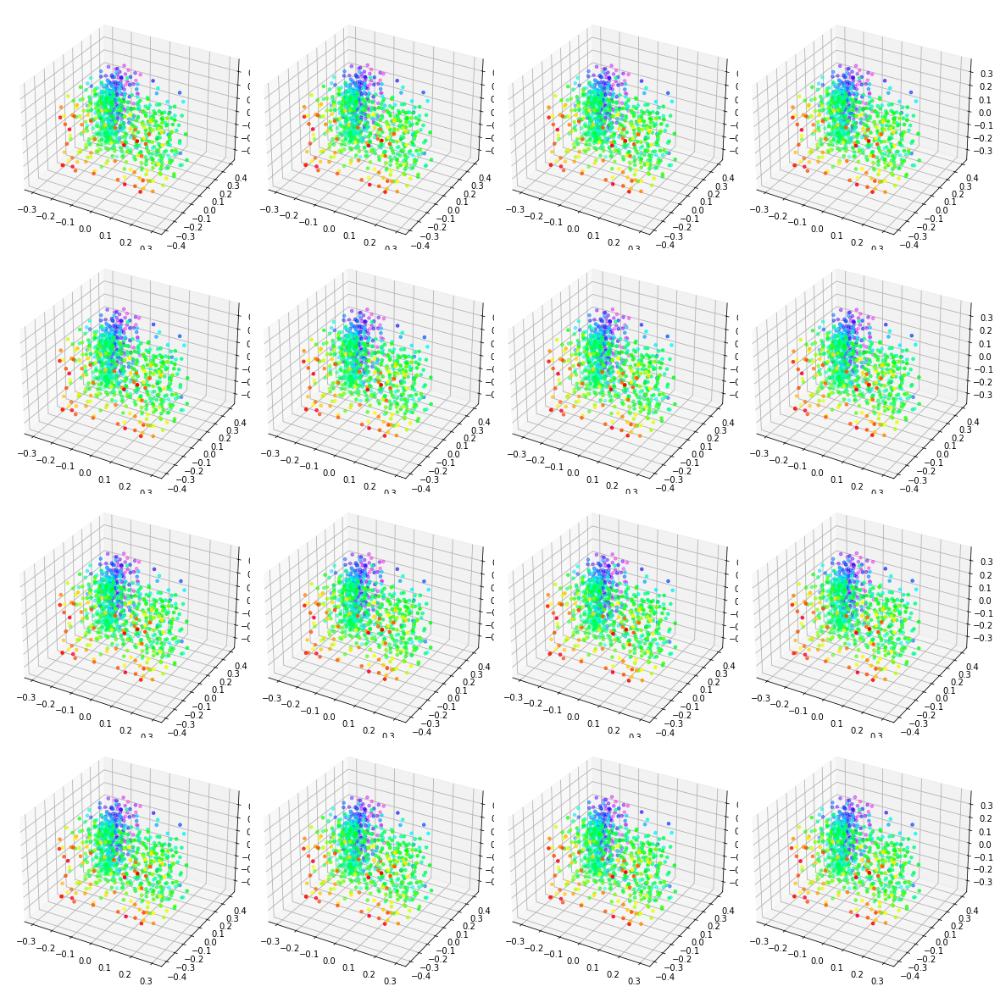

35
0 36/400 4365/121 
loss_g= 0.13223, 
loss_e=-0.04575, 
en_pos=[ -0.16255,  -0.17169,  -0.00914], 
en_neg=[ -0.11680,  -0.10647,   0.01033], 
|z_g_0|=45.183, 
|z_g_k|=46.689, 
|z_e_0|=45.298, 
|z_e_k|=46.750, 
z_e_disp=65.184, 
z_g_disp=64.825, 
x_e_disp= 0.277, 
prior_moments=[   -0.01,     1.03,     4.25], 
posterior_moments=[    0.00,     1.03,     4.59], 



 ---------------------
0 36/400 4380/121 
loss_g= 0.16788, 
loss_e=-0.00459, 
en_pos=[ -0.13194,  -0.14114,  -0.00919], 
en_neg=[ -0.12735,  -0.11803,   0.00933], 
|z_g_0|=45.430, 
|z_g_k|=46.809, 
|z_e_0|=45.397, 
|z_e_k|=46.676, 
z_e_disp=64.947, 
z_g_disp=64.808, 
x_e_disp= 0.252, 
prior_moments=[   -0.00,     1.03,     4.37], 
posterior_moments=[   -0.01,     1.03,     4.47], 



 ---------------------
0 36/400 4395/121 
loss_g= 0.17167, 
loss_e=-0.00015, 
en_pos=[ -0.12838,  -0.13818,  -0.00980], 
en_neg=[ -0.12823,  -0.11859,   0.00965], 
|z_g_0|=45.298, 
|z_g_k|=46.929, 
|z_e_0|=45.227, 
|z_e_k|=46.795, 
z_e_disp=65.02

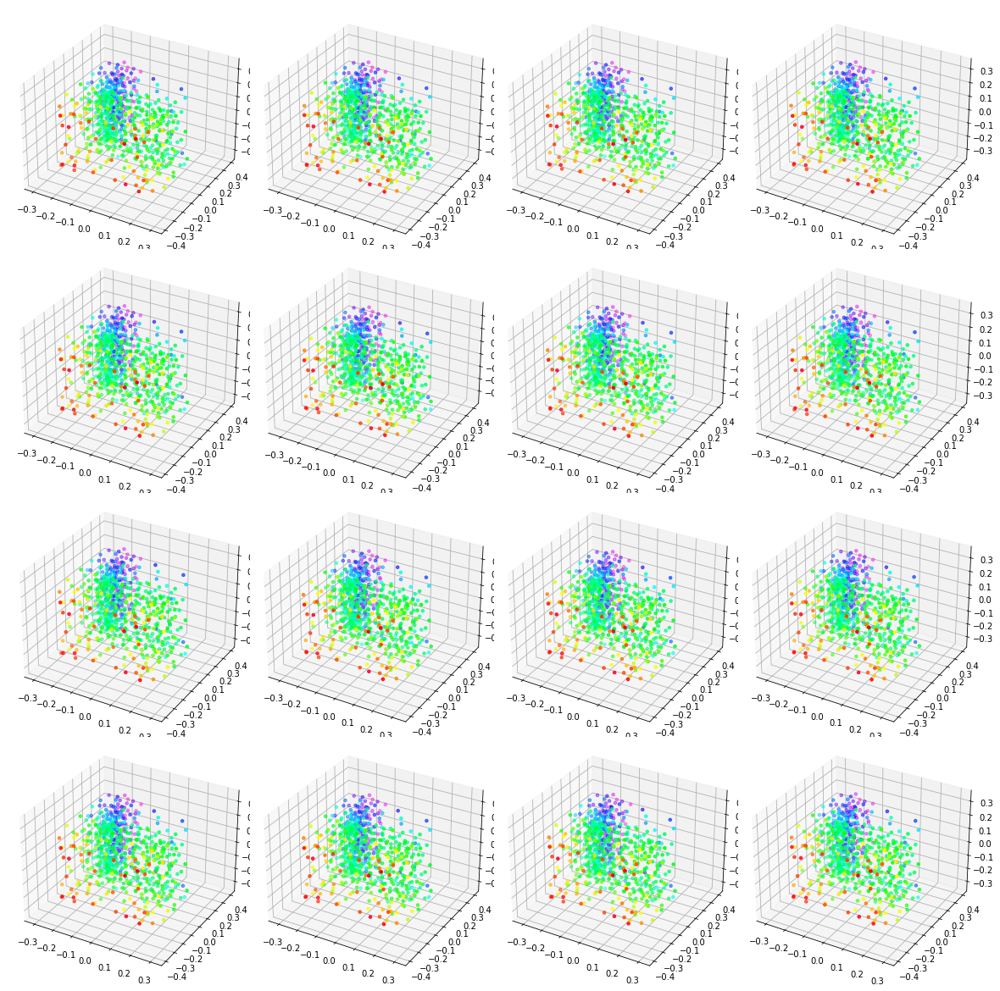

36
0 37/400 4485/121 
loss_g= 0.14031, 
loss_e=-0.03451, 
en_pos=[ -0.17949,  -0.18865,  -0.00916], 
en_neg=[ -0.14498,  -0.13503,   0.00995], 
|z_g_0|=45.017, 
|z_g_k|=46.868, 
|z_e_0|=45.278, 
|z_e_k|=46.716, 
z_e_disp=65.075, 
z_g_disp=64.779, 
x_e_disp= 0.279, 
prior_moments=[    0.00,     1.03,     4.72], 
posterior_moments=[    0.00,     1.04,     4.42], 



 ---------------------
0 37/400 4500/121 
loss_g= 0.17181, 
loss_e= 0.01787, 
en_pos=[ -0.14822,  -0.15762,  -0.00939], 
en_neg=[ -0.16609,  -0.15683,   0.00926], 
|z_g_0|=45.135, 
|z_g_k|=46.562, 
|z_e_0|=45.338, 
|z_e_k|=46.667, 
z_e_disp=65.042, 
z_g_disp=64.762, 
x_e_disp= 0.284, 
prior_moments=[   -0.01,     1.03,     4.53], 
posterior_moments=[   -0.00,     1.03,     4.61], 



 ---------------------
0 37/400 4515/121 
loss_g= 0.14785, 
loss_e=-0.00105, 
en_pos=[ -0.15270,  -0.16203,  -0.00932], 
en_neg=[ -0.15165,  -0.14256,   0.00909], 
|z_g_0|=45.269, 
|z_g_k|=46.800, 
|z_e_0|=45.322, 
|z_e_k|=46.831, 
z_e_disp=65.08

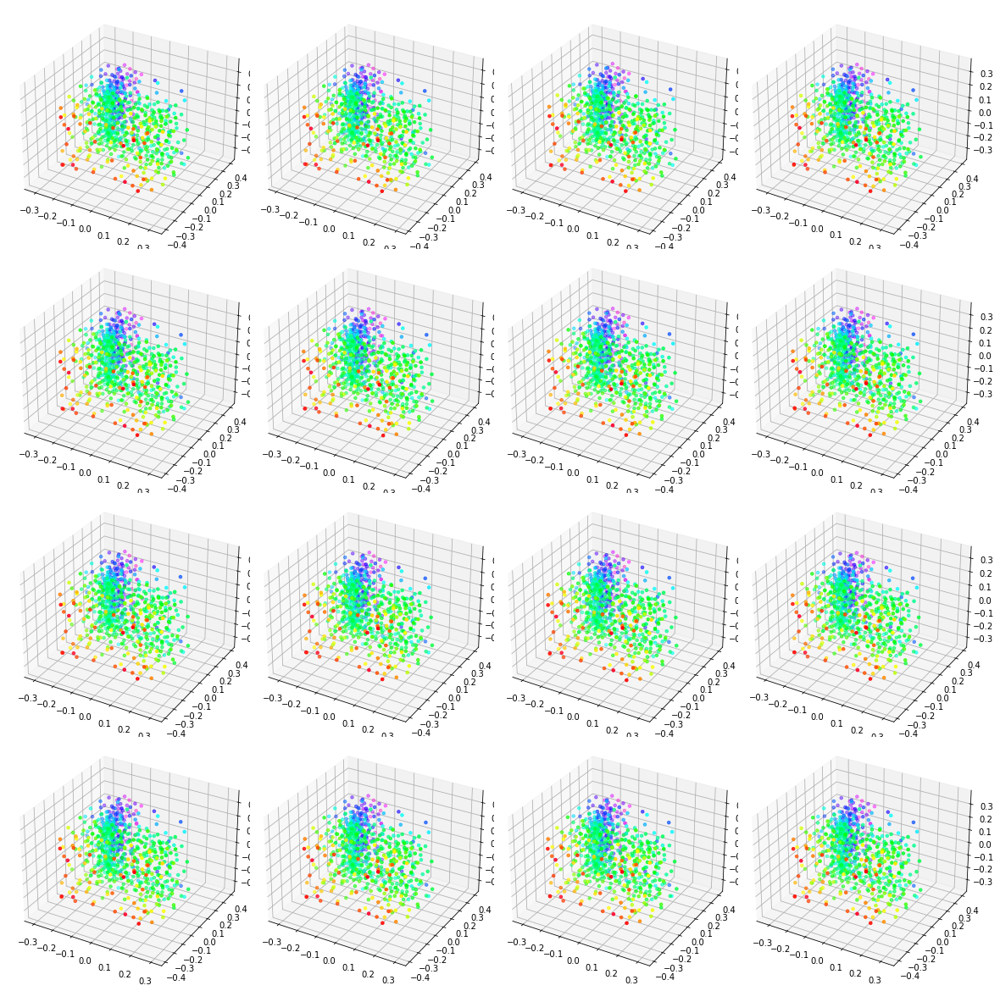

37
0 38/400 4605/121 
loss_g= 0.14612, 
loss_e=-0.03775, 
en_pos=[ -0.14517,  -0.15504,  -0.00987], 
en_neg=[ -0.10742,  -0.09793,   0.00950], 
|z_g_0|=45.268, 
|z_g_k|=46.720, 
|z_e_0|=45.293, 
|z_e_k|=46.619, 
z_e_disp=65.152, 
z_g_disp=64.755, 
x_e_disp= 0.267, 
prior_moments=[    0.00,     1.03,     4.53], 
posterior_moments=[    0.00,     1.03,     4.50], 



 ---------------------
0 38/400 4620/121 
loss_g= 0.16377, 
loss_e=-0.00543, 
en_pos=[ -0.13042,  -0.14046,  -0.01003], 
en_neg=[ -0.12499,  -0.11542,   0.00957], 
|z_g_0|=45.005, 
|z_g_k|=46.743, 
|z_e_0|=45.060, 
|z_e_k|=46.846, 
z_e_disp=64.913, 
z_g_disp=64.681, 
x_e_disp= 0.270, 
prior_moments=[    0.00,     1.04,     4.67], 
posterior_moments=[   -0.00,     1.03,     4.57], 



 ---------------------


KeyboardInterrupt: 

In [19]:
%matplotlib inline

for epoch in tqdm(range(100)):
#     if epoch > 0:
#         break
    # Train phase
    net.train()
    for c, x in enumerate(train_loader):
        total_step += 1
        batch_num = x.shape[0]

        if torch.cuda.is_available():
            x = x.to("cuda")

        # Initialize chains
        z_g_0 = sample_p_0(n = batch_num,sig=e_init_sig, device = x.device)
        z_e_0 = sample_p_0(n = batch_num,sig=e_init_sig, device = x.device)

#         print("shape log")
#         print(x.shape)
#         print(z_g_0.shape)
#         print(z_e_0.shape)

        # Langevin posterior and prior
        z_g_k = net(Variable(z_g_0), x, prior=False)
        z_e_k = net(Variable(z_e_0), prior=True)
        
        # print("z_g_k", z_g_k)
        # print("z_e_k shape", z_e_k.shape)
        
        # Learn generator
        optG.zero_grad()
        x_hat = net.netG(z_g_k.detach())
        
        #print("x_hat shape", x_hat.shape)
        
        loss_g = net.loss_fun(x_hat.transpose(1,2).contiguous(), x.transpose(1,2).contiguous())
        loss_g.backward()
        optG.step()

        # Learn prior EBM
        optE.zero_grad()
        en_neg = energy(net.netE(z_e_k.detach())).mean() # TODO(nijkamp): why mean() here and in Langevin sum() over energy? constant is absorbed into Adam adaptive lr
        en_pos = energy(net.netE(z_g_k.detach())).mean()
        loss_e = en_pos - en_neg
        loss_e.backward()
        # grad_norm_e = get_grad_norm(net.netE.parameters())
        # if args.e_is_grad_clamp:
        #    torch.nn.utils.clip_grad_norm_(net.netE.parameters(), args.e_max_norm)
        optE.step()
        
        # break
        
        # Printout
        if total_step % 15 == 0:
            with torch.no_grad():
                x_0 = net.netG(z_e_0)
                x_k = net.netG(z_e_k)

                en_neg_2 = energy(net.netE(z_e_k)).mean()
                en_pos_2 = energy(net.netE(z_g_k)).mean()

                prior_moments = '[{:8.2f}, {:8.2f}, {:8.2f}]'.format(z_e_k.mean(), z_e_k.std(), z_e_k.abs().max())
                posterior_moments = '[{:8.2f}, {:8.2f}, {:8.2f}]'.format(z_g_k.mean(), z_g_k.std(), z_g_k.abs().max())
                
                
                if use_tensorboard:
                    writer.add_scalar('loss/loss_g',loss_g, total_step)
                    writer.add_scalar('loss/loss_e',loss_e, total_step)

                    writer.add_scalars('energy/en_pos', {'pos_1':en_pos,
                                        'pose_2':en_pos_2,
                                        'diff': en_pos_2 - en_pos}, total_step)
                    writer.add_scalars('energy/en_neg', {'pos_1':en_neg,
                                        'pose_2':en_neg_2,
                                        'diff': en_neg_2 - en_neg}, total_step)

                    writer.add_scalar('value/|z_g_0|',z_g_0.view(batch_num, -1).norm(dim=1).mean(), total_step)
                    writer.add_scalar('value/|z_g_k|',z_g_k.view(batch_num, -1).norm(dim=1).mean(), total_step)
                    writer.add_scalar('value/|z_e_0|',z_e_0.view(batch_num, -1).norm(dim=1).mean(), total_step)
                    writer.add_scalar('value/|z_e_k|',z_e_k.view(batch_num, -1).norm(dim=1).mean(), total_step)

                    writer.add_scalar('disp/z_e_disp',(z_e_k-z_e_0).view(batch_num, -1).norm(dim=1).mean(), total_step)
                    writer.add_scalar('disp/z_g_disp',(z_g_k-z_g_0).view(batch_num, -1).norm(dim=1).mean(), total_step)
                    writer.add_scalar('disp/x_e_disp',(x_k-x_0).view(batch_num, -1).norm(dim=1).mean(), total_step)

                    writer.add_scalars('moment/prior_moments', {'mean':z_e_k.mean(),
                                        'std':z_e_k.std(),
                                        'max abs': z_e_k.abs().max()}, total_step)
                    writer.add_scalars('moment/posterior_moments', {'mean':z_g_k.mean(),
                                        'std':z_g_k.std(),
                                        'max abs': z_g_k.abs().max()}, total_step)
                else:
                    print(
                        '{} {}/{} {}/{} \n'.format(0, epoch, n_epochs, total_step, len(train_loader)) +
                        'loss_g={:8.5f}, \n'.format(loss_g) +
                        'loss_e={:8.5f}, \n'.format(loss_e) +
                        'en_pos=[{:9.5f}, {:9.5f}, {:9.5f}], \n'.format(en_pos, en_pos_2, en_pos_2-en_pos) +
                        'en_neg=[{:9.5f}, {:9.5f}, {:9.5f}], \n'.format(en_neg, en_neg_2, en_neg_2-en_neg) +
                        '|z_g_0|={:6.3f}, \n'.format(z_g_0.view(batch_num, -1).norm(dim=1).mean()) +
                        '|z_g_k|={:6.3f}, \n'.format(z_g_k.view(batch_num, -1).norm(dim=1).mean()) +
                        '|z_e_0|={:6.3f}, \n'.format(z_e_0.view(batch_num, -1).norm(dim=1).mean()) +
                        '|z_e_k|={:6.3f}, \n'.format(z_e_k.view(batch_num, -1).norm(dim=1).mean()) +
                        'z_e_disp={:6.3f}, \n'.format((z_e_k-z_e_0).view(batch_num, -1).norm(dim=1).mean()) +
                        'z_g_disp={:6.3f}, \n'.format((z_g_k-z_g_0).view(batch_num, -1).norm(dim=1).mean()) +
                        'x_e_disp={:6.3f}, \n'.format((x_k-x_0).view(batch_num, -1).norm(dim=1).mean()) +
                        'prior_moments={}, \n'.format(prior_moments) +
                        'posterior_moments={}, \n'.format(posterior_moments) +
                        #'fid={:8.2f}, '.format(fid) +
                        #'fid_best={:8.2f}'.format(fid_best)
                        "\n\n\n ---------------------"
                    )
     
    # Eval phase
  
    net.eval()  _x(n=16)
#     res = quantitativ e_analysis(syn_pcs.data.numpy(), ref_pcs, 16, full=False)
 #         writer.add _scalar('test_record/jsd', res['jsd'], epoch)
 #         writer.ad d_scalar('test_record/mmd-EMD', res['mmd-EMD'], epoch)
#         writer.add_scalar('test_record/cov-CD', res['cov-CD'], epoch)
#         writer.add_scalar('test_record/cov-EMD', res['cov-EMD'], epoch)
#     else:
#         print("epoch {} test record {}".format(epoch ,res))
        
    show_point_clouds(syn_pcs)
    print(epoch)
    plt.show()